In [1]:
from google.colab import drive
drive.mount('/content/drive')



Mounted at /content/drive


In [24]:
!tar -xvf "/content/drive/MyDrive/Object Detection/bbt_sample_frames.tar"

Streaming output truncated to the last 5000 lines.
s01e06_seg02_clip_10/00139.jpg
s01e06_seg02_clip_10/00140.jpg
s01e06_seg02_clip_10/00141.jpg
s01e06_seg02_clip_10/00142.jpg
s01e06_seg02_clip_10/00143.jpg
s01e06_seg02_clip_10/00144.jpg
s01e06_seg02_clip_10/00145.jpg
s01e06_seg02_clip_10/00146.jpg
s01e06_seg02_clip_10/00147.jpg
s01e06_seg02_clip_10/00148.jpg
s01e06_seg02_clip_10/00149.jpg
s01e06_seg02_clip_10/00150.jpg
s01e06_seg02_clip_10/00151.jpg
s01e06_seg02_clip_10/00152.jpg
s01e06_seg02_clip_10/00153.jpg
s01e06_seg02_clip_10/00154.jpg
s01e06_seg02_clip_10/00155.jpg
s01e06_seg02_clip_10/00156.jpg
s01e06_seg02_clip_10/00157.jpg
s01e06_seg02_clip_10/00158.jpg
s01e06_seg02_clip_10/00159.jpg
s01e06_seg02_clip_10/00160.jpg
s01e06_seg02_clip_10/00161.jpg
s01e06_seg02_clip_10/00162.jpg
s01e06_seg02_clip_10/00163.jpg
s01e06_seg02_clip_10/00164.jpg
s01e06_seg02_clip_10/00165.jpg
s01e06_seg02_clip_10/00166.jpg
s01e06_seg02_clip_10/00167.jpg
s01e06_seg02_clip_10/00168.jpg
s01e06_seg02_clip_1

In [12]:
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image
from torchvision.models.detection import retinanet_resnet50_fpn_v2, RetinaNet_ResNet50_FPN_V2_Weights, SSDLite320_MobileNet_V3_Large_Weights, ssdlite320_mobilenet_v3_large 
import matplotlib.pyplot as plt
import torch
import os

In [14]:
import requests
# response = requests.get('https://i.ytimg.com/vi/q71MCWAEfL8/maxresdefault.jpg')
# open("obj_det.jpeg", "wb").write(response.content)

dir_path = "/content/varun_sample_data"
img_list = []
for path in os.listdir(dir_path):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path, path)):
        img_list.append(os.path.join(dir_path, path))

print(img_list)
imgList = [read_image(img) for img in img_list]
# imgList = torch.stack(imgList, dim = 0)

print(imgList)

['/content/varun_sample_data/00170.jpg', '/content/varun_sample_data/00033.jpg', '/content/varun_sample_data/00197.jpg', '/content/varun_sample_data/00140.jpg', '/content/varun_sample_data/003.jpg', '/content/varun_sample_data/069.jpg', '/content/varun_sample_data/00122.jpg', '/content/varun_sample_data/00120.jpg', '/content/varun_sample_data/00084.jpg', '/content/varun_sample_data/00024.jpg', '/content/varun_sample_data/00085.jpg', '/content/varun_sample_data/00086.jpg', '/content/varun_sample_data/00072.jpg', '/content/varun_sample_data/00166.jpg', '/content/varun_sample_data/00203.jpg', '/content/varun_sample_data/00141.jpg', '/content/varun_sample_data/00206.jpg', '/content/varun_sample_data/00172.jpg', '/content/varun_sample_data/156.jpg', '/content/varun_sample_data/000.jpg', '/content/varun_sample_data/00134.jpg', '/content/varun_sample_data/00173.jpg', '/content/varun_sample_data/00007.jpg', '/content/varun_sample_data/00133.jpg', '/content/varun_sample_data/00062.jpg', '/conte

In [15]:
weights = SSDLite320_MobileNet_V3_Large_Weights.DEFAULT
model = ssdlite320_mobilenet_v3_large(weights=weights, score_thresh=0.35)
# Put the model in inference mode
model.eval()
# Get the transforms for the model's weights
preprocess = weights.transforms()

Downloading: "https://download.pytorch.org/models/ssdlite320_mobilenet_v3_large_coco-a79551df.pth" to /root/.cache/torch/hub/checkpoints/ssdlite320_mobilenet_v3_large_coco-a79551df.pth


  0%|          | 0.00/13.4M [00:00<?, ?B/s]

{'boxes': tensor([[174.7322,  23.2855, 431.9486, 359.9650]], grad_fn=<StackBackward0>), 'scores': tensor([0.9875], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


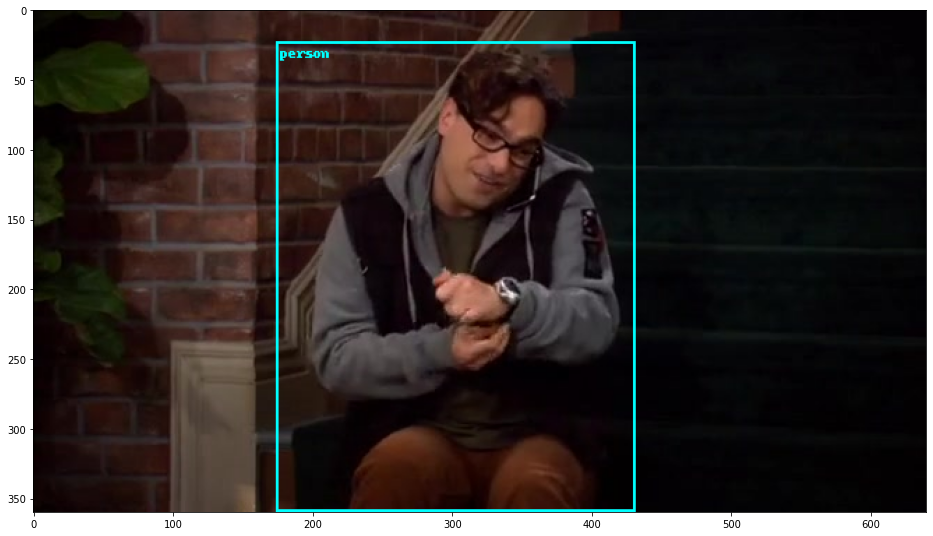

{'boxes': tensor([[196.9925,  33.4466, 424.0934, 357.3819],
        [516.4781,   8.6344, 635.2449, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.9868, 0.7809], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


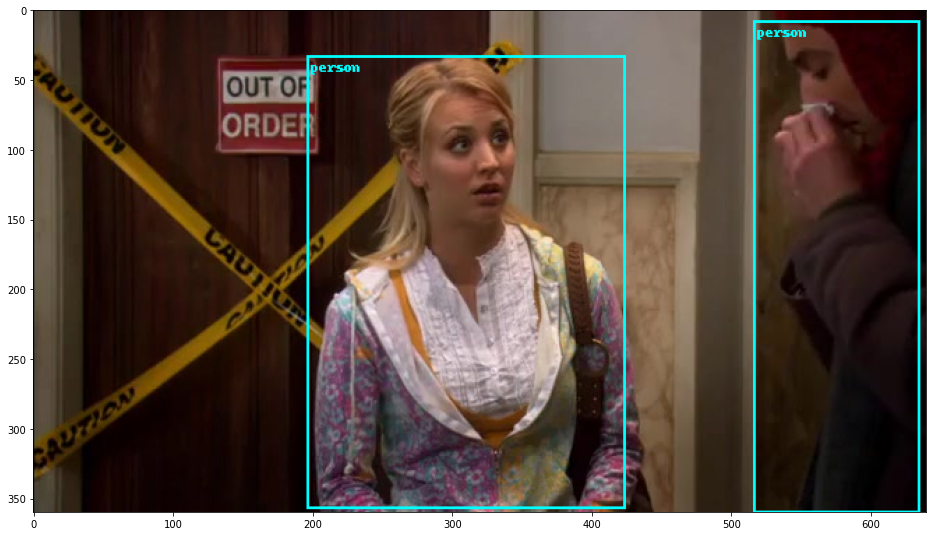

{'boxes': tensor([[209.8193,  34.0667, 393.7233, 356.1166],
        [456.9241, 132.9348, 630.2803, 357.9209],
        [ 91.4507,   2.1198, 197.3112, 222.6897],
        [496.1206,   1.7235, 606.1648,  61.1569]], grad_fn=<StackBackward0>), 'scores': tensor([0.9675, 0.8024, 0.4270, 0.3810], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 64,  1])}


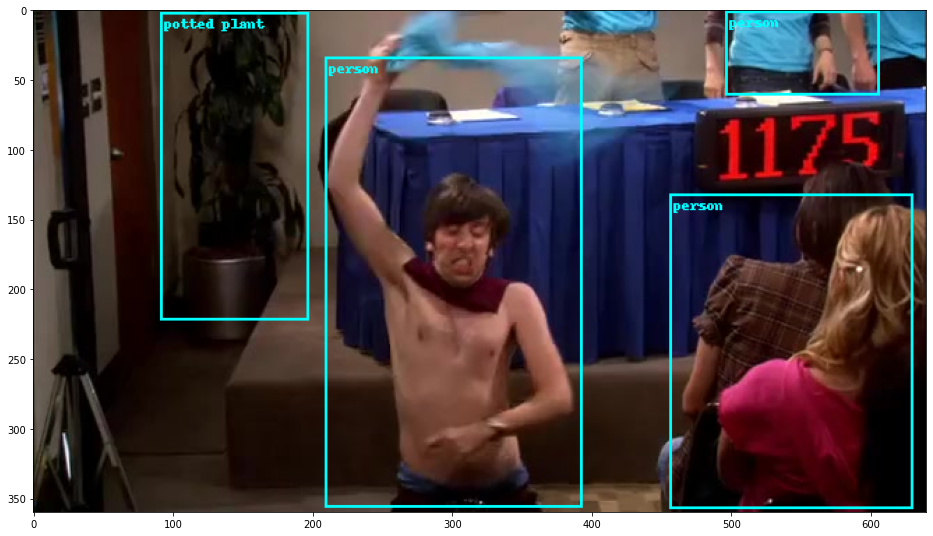

{'boxes': tensor([[260.9189,  15.2498, 483.8042, 360.0000],
        [ 30.5782, 197.9788, 249.7527, 353.9382]], grad_fn=<StackBackward0>), 'scores': tensor([0.8919, 0.4079], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 62])}


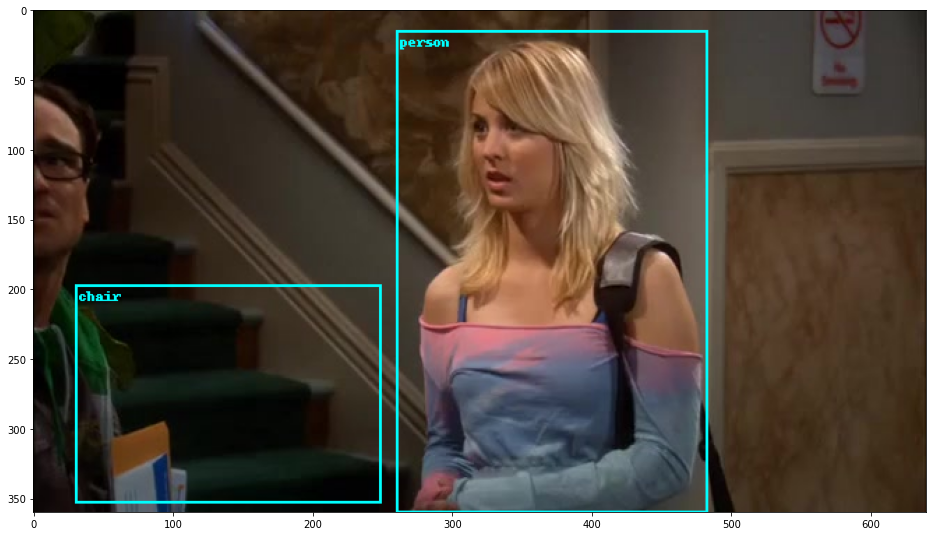

{'boxes': tensor([[248.9913,  30.9023, 494.5061, 356.8987]], grad_fn=<StackBackward0>), 'scores': tensor([0.9460], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


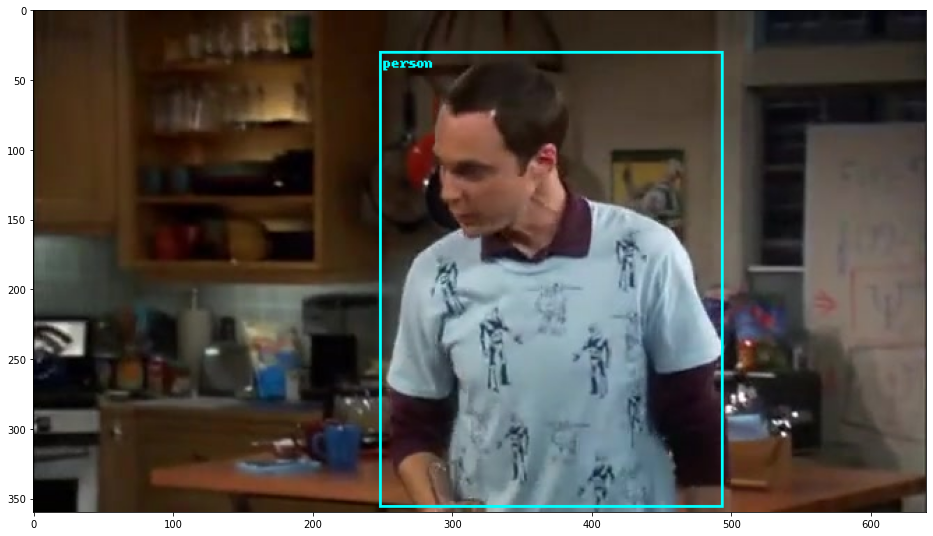

{'boxes': tensor([[140.5079,  23.3938, 416.3152, 354.5844],
        [434.2637,   2.4645, 640.0000, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.9749, 0.9332], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


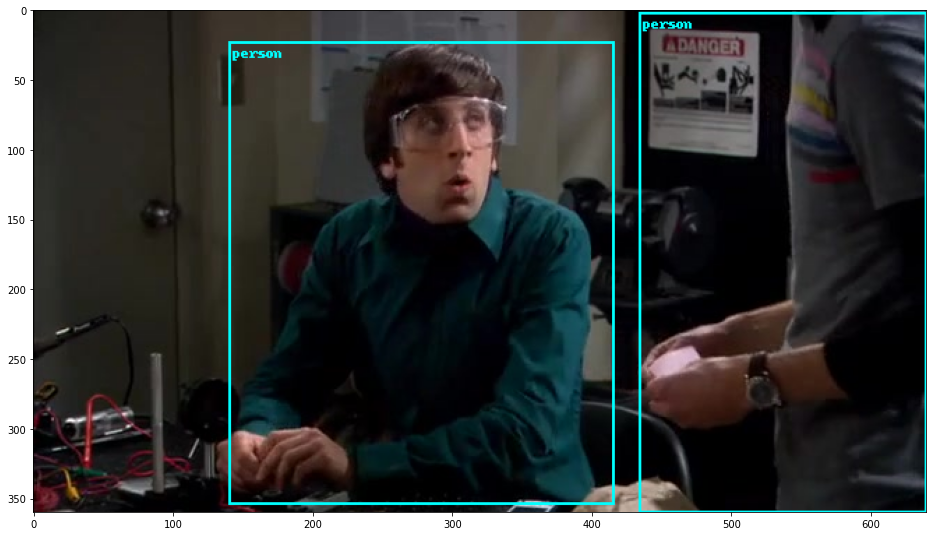

{'boxes': tensor([[151.5000,  15.4682, 424.4765, 360.0000],
        [499.2109,   0.0000, 637.4772, 355.8812]], grad_fn=<StackBackward0>), 'scores': tensor([0.9673, 0.8102], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


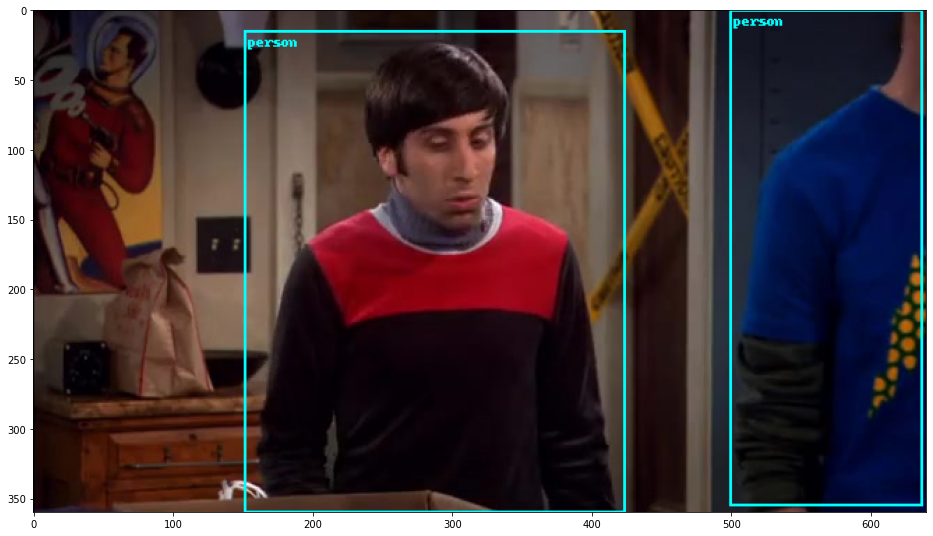

{'boxes': tensor([[210.8529,  34.8307, 449.3653, 355.0393],
        [418.5468, 136.3252, 521.2877, 200.7202],
        [448.5672, 217.0101, 566.4905, 294.1186]], grad_fn=<StackBackward0>), 'scores': tensor([0.9899, 0.4107, 0.3992], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 78, 78])}


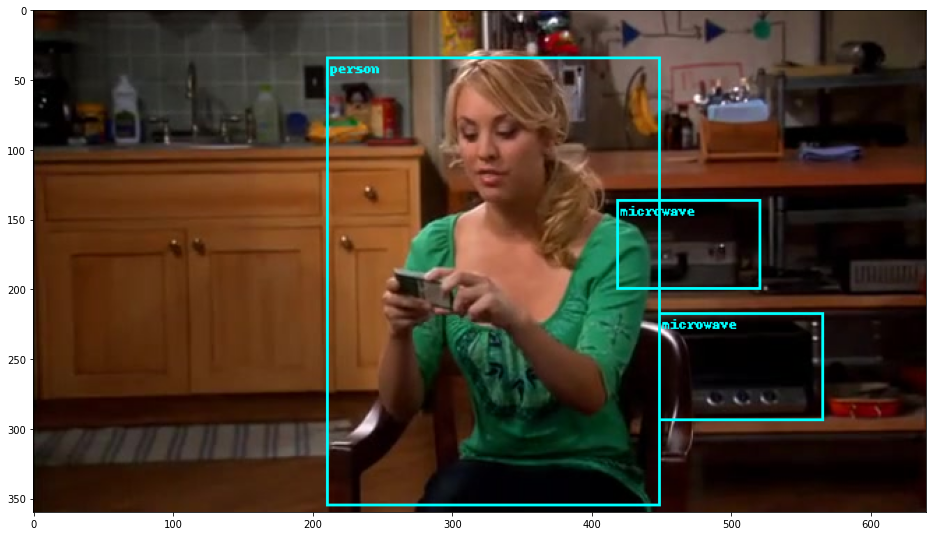

{'boxes': tensor([[104.0533,  28.2152, 500.9102, 357.7372],
        [553.4142, 101.6083, 636.5319, 358.4825]], grad_fn=<StackBackward0>), 'scores': tensor([0.9619, 0.4825], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


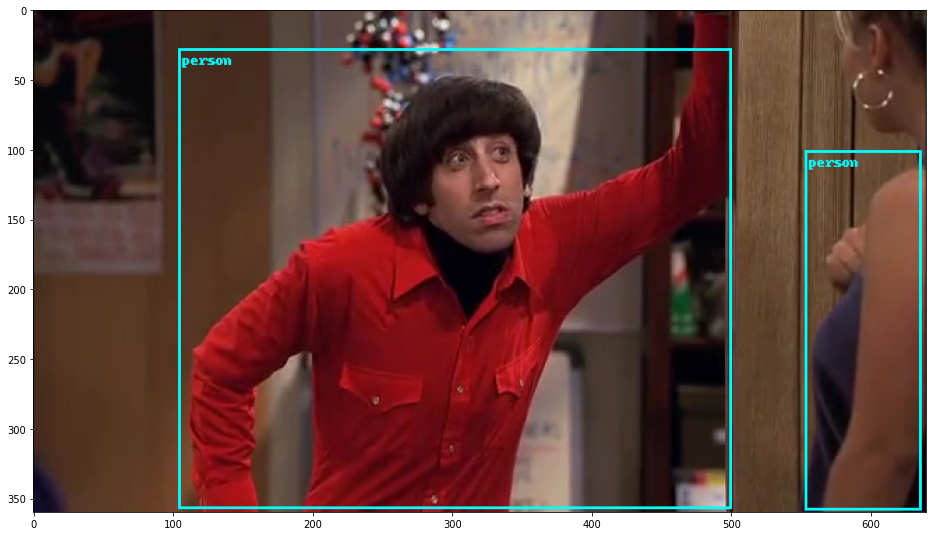

{'boxes': tensor([[165.2619,  32.5217, 407.6862, 356.6049],
        [399.6335,   4.1528, 592.4102, 359.2394]], grad_fn=<StackBackward0>), 'scores': tensor([0.9861, 0.5320], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 82])}


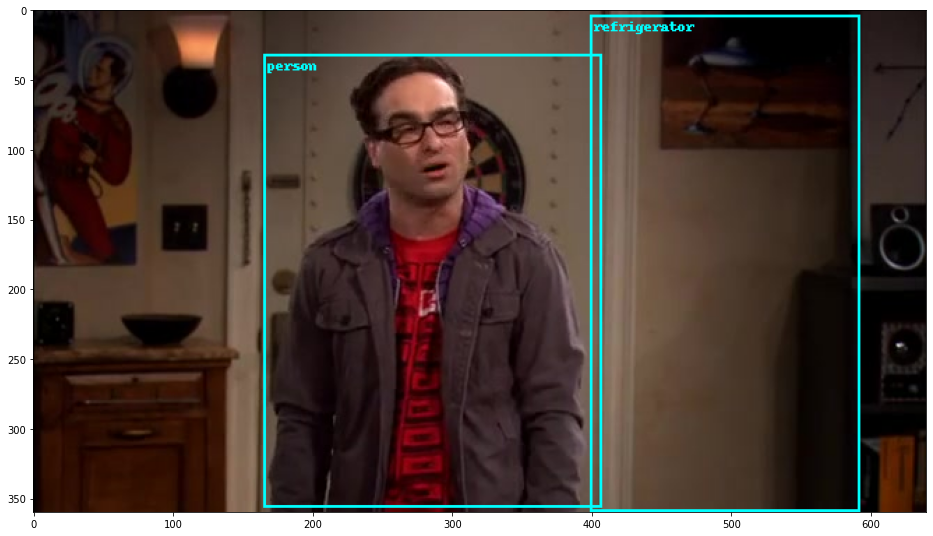

{'boxes': tensor([[  0.0000, 163.3089, 215.1183, 294.0537],
        [186.0010,  16.8961, 414.0868, 336.6989]], grad_fn=<StackBackward0>), 'scores': tensor([0.9803, 0.9797], grad_fn=<IndexBackward0>), 'labels': tensor([78,  1])}


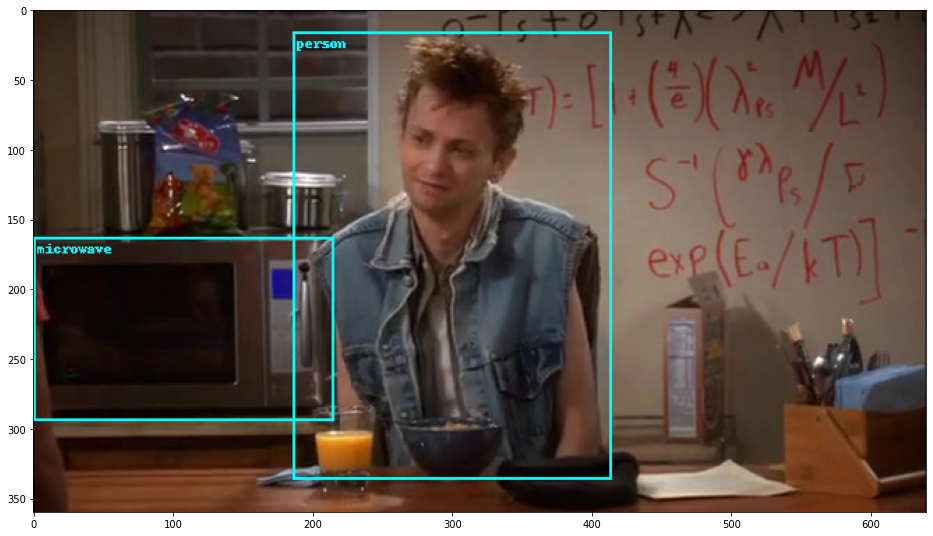

{'boxes': tensor([[493.4630,   0.0000, 639.5775, 356.8045],
        [172.0055,  19.1253, 499.9555, 352.3601],
        [296.4620,   0.0000, 501.7297, 207.1964]], grad_fn=<StackBackward0>), 'scores': tensor([0.9371, 0.8890, 0.3741], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 64])}


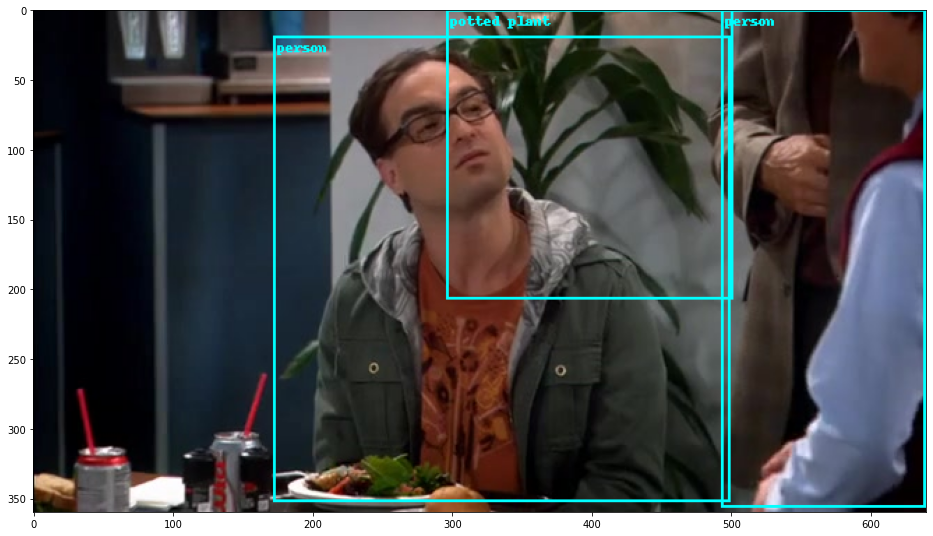

{'boxes': tensor([[217.7705,  27.2759, 496.1285, 358.6026],
        [  0.0000,  36.8138, 158.9362, 357.3894],
        [486.1885, 220.0353, 624.3972, 351.7708]], grad_fn=<StackBackward0>), 'scores': tensor([0.9954, 0.9267, 0.7014], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 62])}


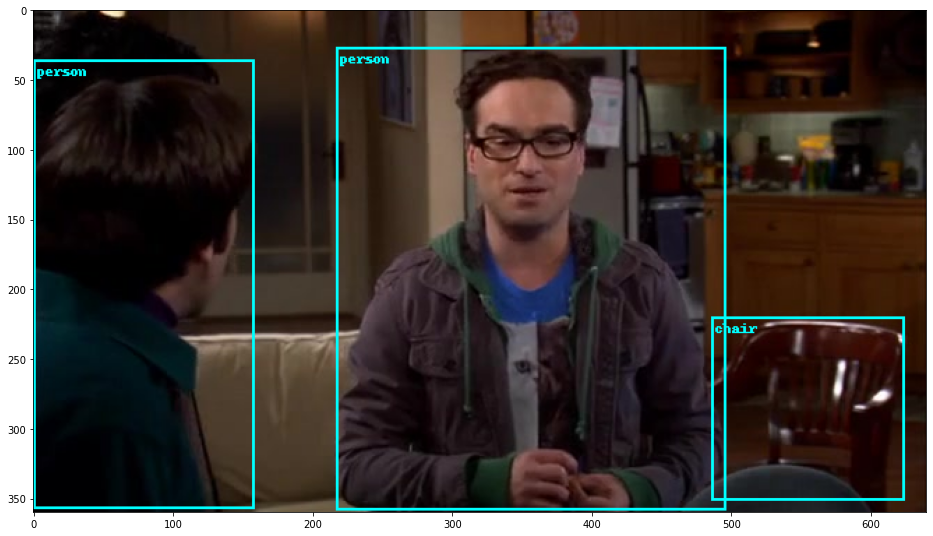

{'boxes': tensor([[227.1895,  50.6926, 448.3181, 247.2747],
        [  7.8303,  85.4344, 400.0405, 356.7059]], grad_fn=<StackBackward0>), 'scores': tensor([0.6857, 0.4569], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 65])}


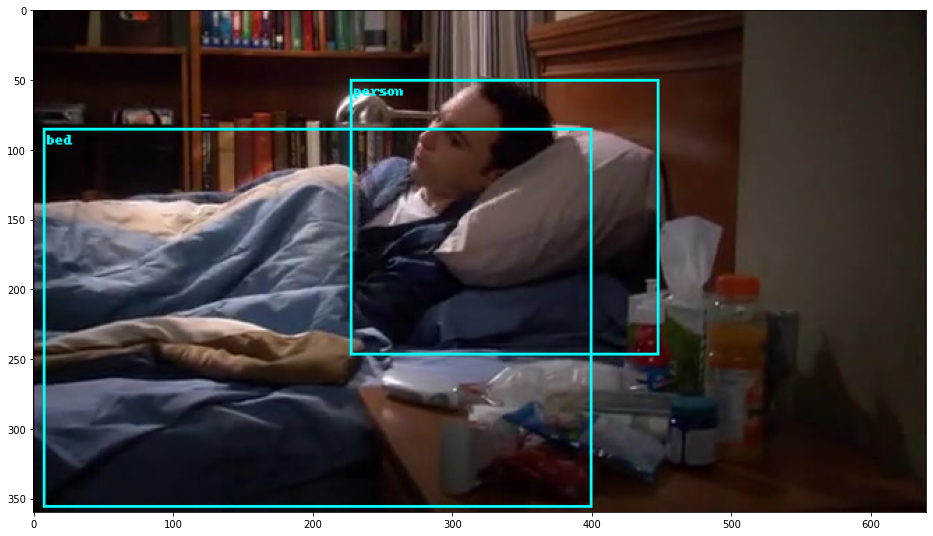

{'boxes': tensor([[ 37.2310,  21.1800, 485.1579, 357.7508]], grad_fn=<StackBackward0>), 'scores': tensor([0.9356], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


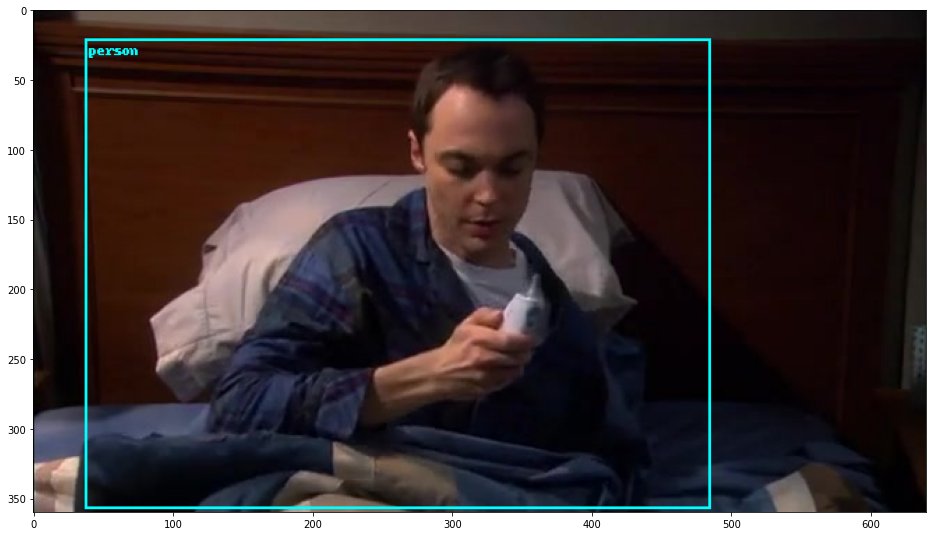

{'boxes': tensor([[167.5427,  26.4449, 480.7136, 355.7595],
        [180.1707, 246.5482, 253.5063, 358.1900],
        [  1.4629, 199.5813, 101.3875, 332.9017],
        [329.8504,   5.1649, 486.9186, 216.1461],
        [143.0904,   0.0000, 283.3020, 224.6195]], grad_fn=<StackBackward0>), 'scores': tensor([0.9564, 0.6226, 0.5691, 0.4815, 0.4697], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 47, 62,  1,  1])}


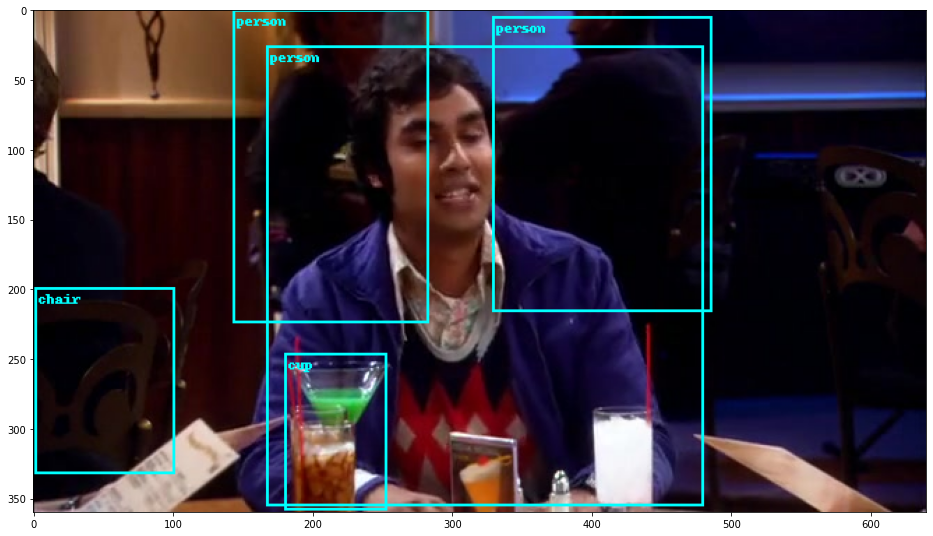

{'boxes': tensor([[106.5280,  37.2124, 348.7520, 355.8704],
        [298.7827,  58.0498, 529.3901, 356.8186]], grad_fn=<StackBackward0>), 'scores': tensor([0.9816, 0.9714], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


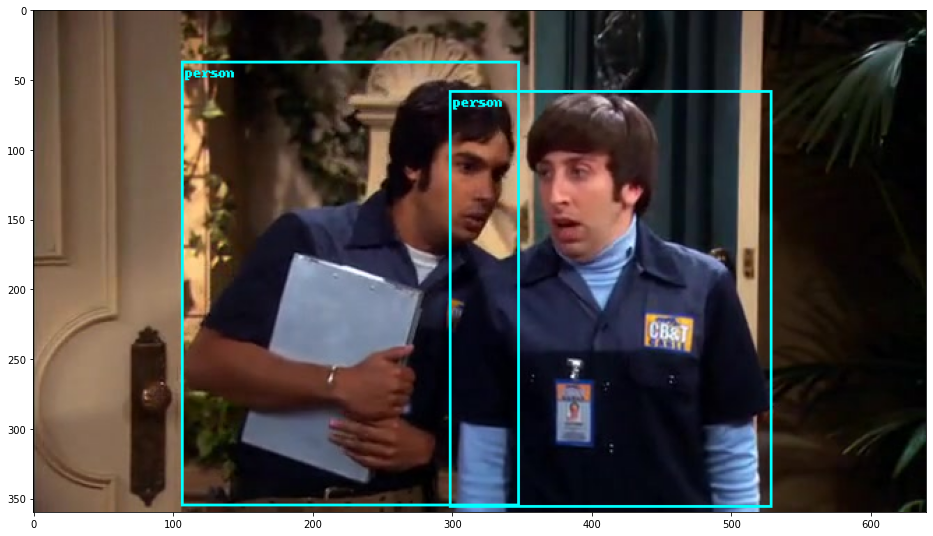

{'boxes': tensor([[190.6602,  19.3054, 471.6994, 357.3965]], grad_fn=<StackBackward0>), 'scores': tensor([0.9971], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


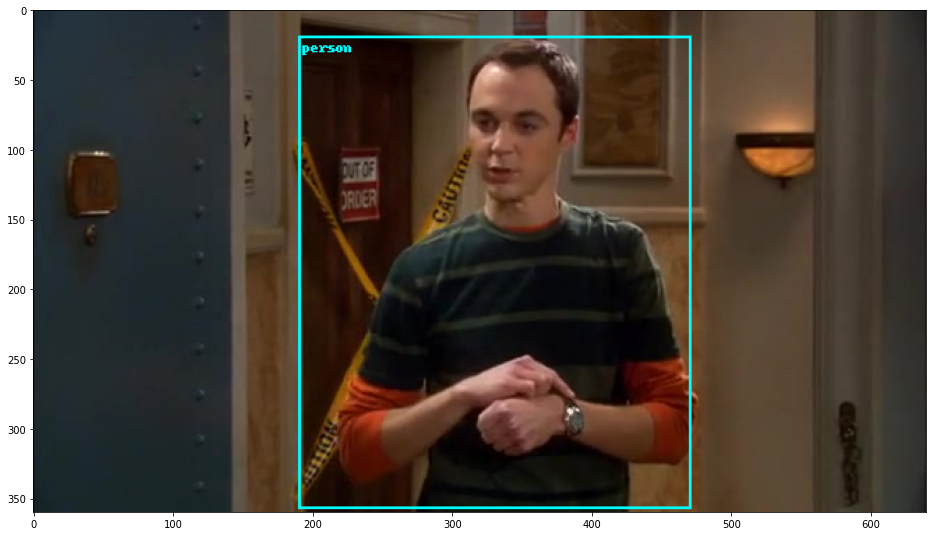

{'boxes': tensor([[115.2455,  16.7646, 330.9609, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.8724], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


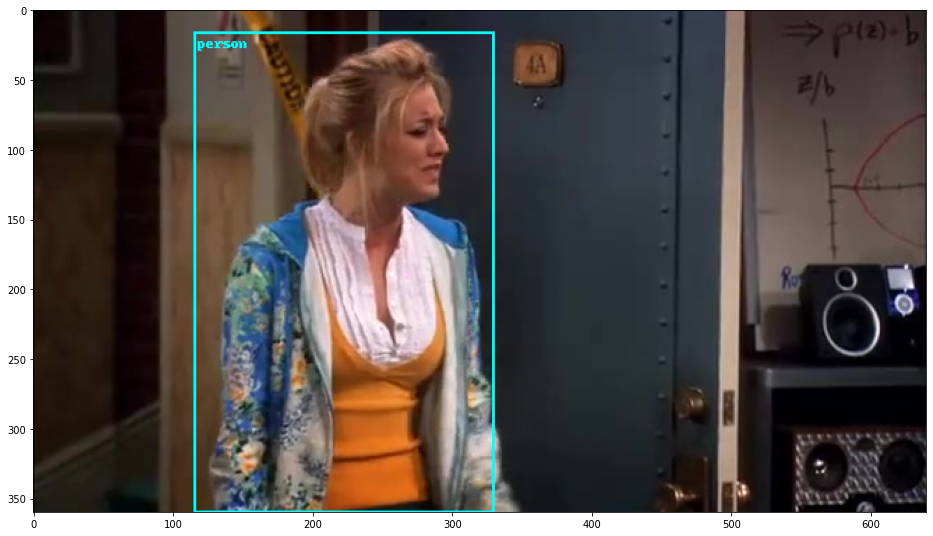

{'boxes': tensor([[156.4826,  27.3586, 498.0460, 359.6912],
        [506.3120,   5.2184, 636.0630, 358.5523],
        [294.0765,   0.0000, 500.0882, 209.4162],
        [493.0937,  45.2799, 597.3611, 342.8438],
        [244.4799,   5.6041, 508.3716, 318.6688]], grad_fn=<StackBackward0>), 'scores': tensor([0.8922, 0.8755, 0.5366, 0.4438, 0.3537], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 64,  1, 64])}


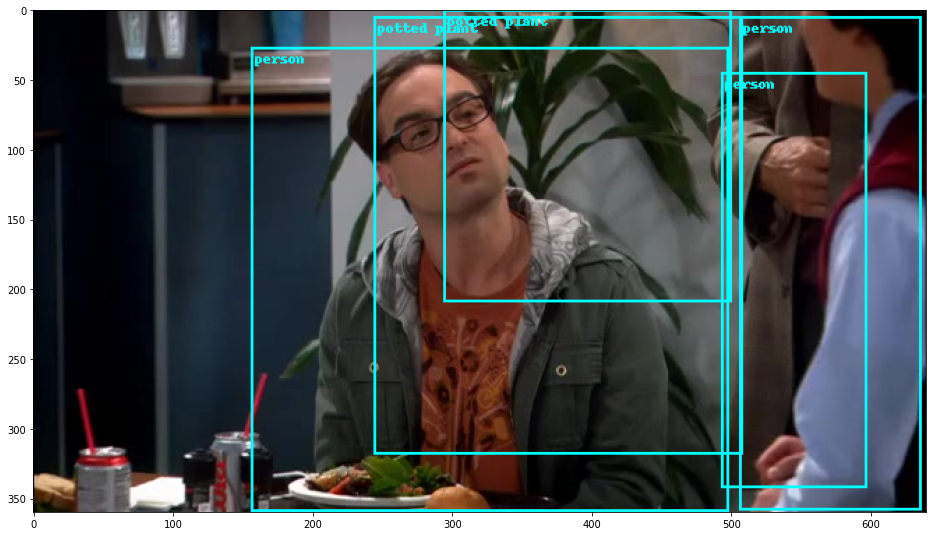

{'boxes': tensor([[154.5967,  35.9883, 468.4058, 356.8987],
        [  0.0000,  42.3790, 158.0171, 353.9419],
        [465.2290,  54.1784, 638.4730, 352.9566],
        [326.4076,  44.3437, 410.4497, 186.3682],
        [387.8717,  20.1448, 490.3201, 159.1919],
        [487.3603,   7.7879, 577.7174, 141.6307],
        [345.4504,  27.8551, 484.3845, 215.2046],
        [287.7813, 255.3392, 335.9834, 358.7646]], grad_fn=<StackBackward0>), 'scores': tensor([0.9931, 0.9659, 0.8396, 0.8060, 0.6597, 0.6062, 0.3770, 0.3513],
       grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1,  1,  1,  1,  1,  1, 44])}


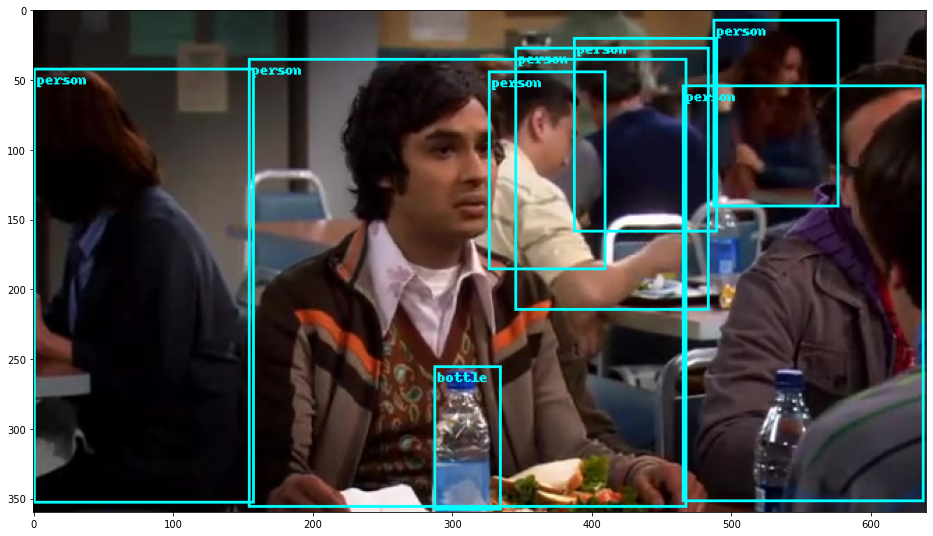

{'boxes': tensor([[127.8764,  24.2383, 411.3981, 356.7221],
        [455.3575,   3.1894, 640.0000, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.9701, 0.7101], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


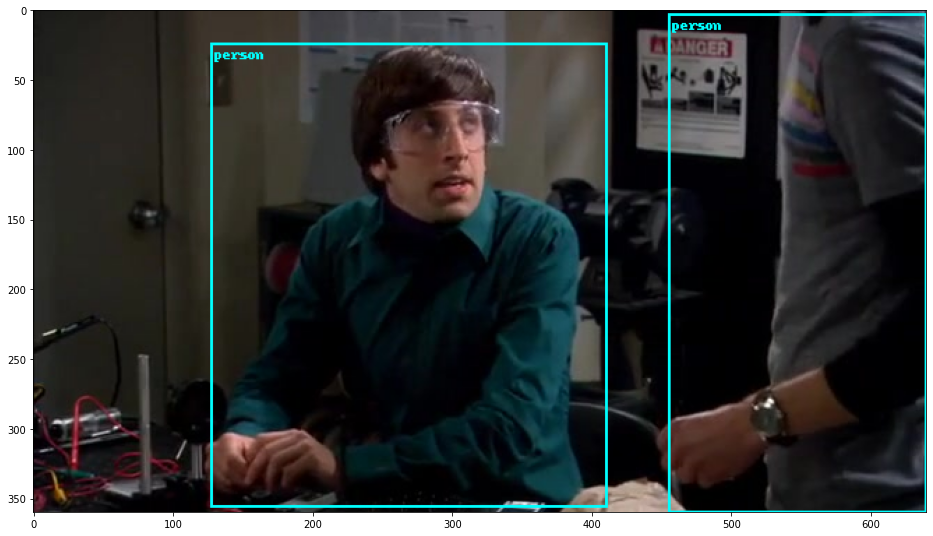

{'boxes': tensor([[137.6129,  24.5964, 495.4970, 352.6104],
        [  4.0025,  56.4976, 271.1529, 353.4173]], grad_fn=<StackBackward0>), 'scores': tensor([0.9744, 0.3848], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 62])}


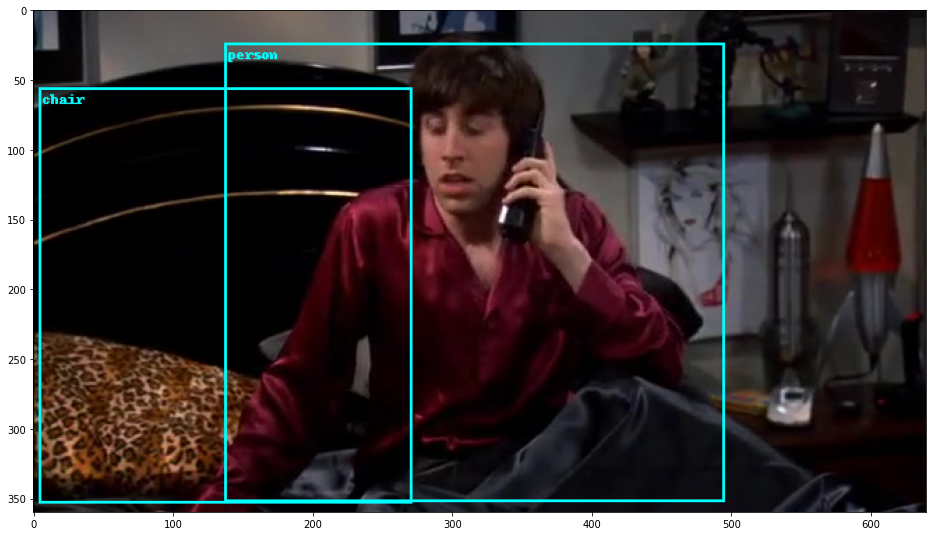

{'boxes': tensor([[1.5600e+02, 3.5926e+01, 4.6222e+02, 3.5695e+02],
        [3.6095e-02, 4.2485e+01, 1.5867e+02, 3.5351e+02],
        [4.7147e+02, 4.9928e+01, 6.3868e+02, 3.5289e+02],
        [3.8703e+02, 2.3243e+01, 4.8797e+02, 1.5306e+02],
        [3.2621e+02, 4.0508e+01, 4.1200e+02, 1.9362e+02],
        [3.4292e+02, 3.1989e+01, 4.8052e+02, 2.3290e+02],
        [4.5499e+02, 3.6945e+00, 5.3047e+02, 1.2848e+02],
        [5.0015e+02, 1.0358e+01, 5.8035e+02, 1.4135e+02],
        [2.8833e+02, 2.5651e+02, 3.3541e+02, 3.5885e+02]],
       grad_fn=<StackBackward0>), 'scores': tensor([0.9921, 0.9693, 0.8538, 0.6503, 0.6369, 0.4857, 0.4843, 0.4213, 0.3814],
       grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 44])}


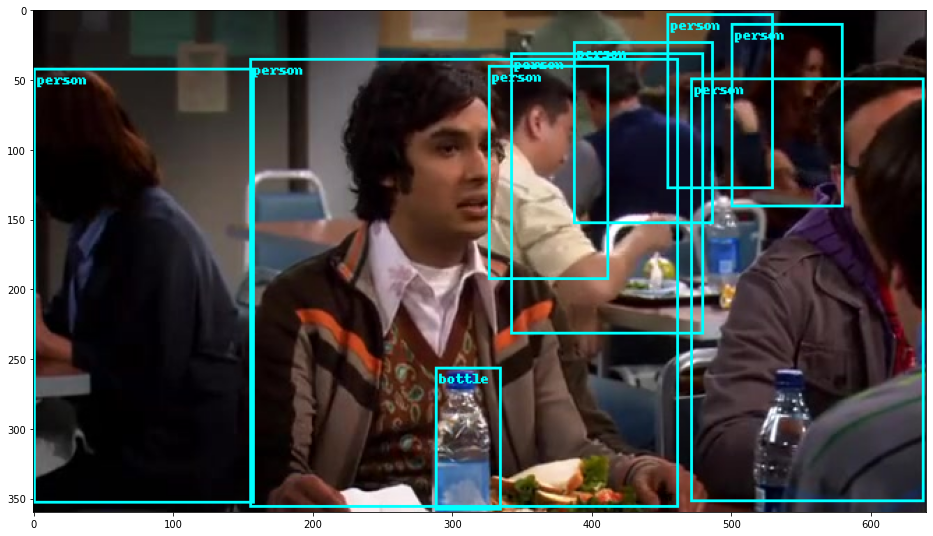

{'boxes': tensor([[230.4694,  26.1248, 475.2725, 294.7576],
        [374.9880, 197.9137, 632.9294, 347.3744],
        [440.2644, 149.2480, 569.9955, 216.8131],
        [  0.0000, 108.0177, 140.1540, 275.1645]], grad_fn=<StackBackward0>), 'scores': tensor([0.9910, 0.6618, 0.5547, 0.4585], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 73, 62, 63])}


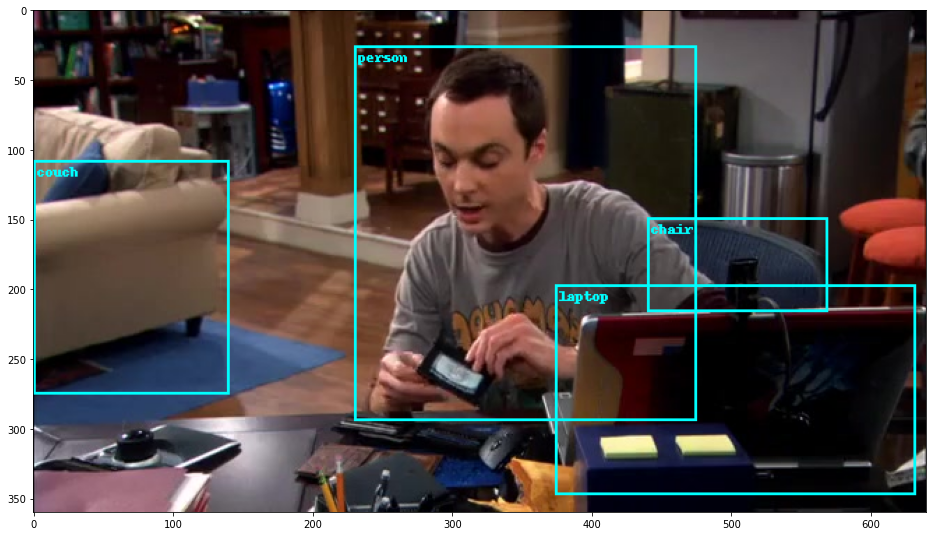

{'boxes': tensor([[240.0617,  18.7383, 432.7723, 355.0120]], grad_fn=<StackBackward0>), 'scores': tensor([0.9805], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


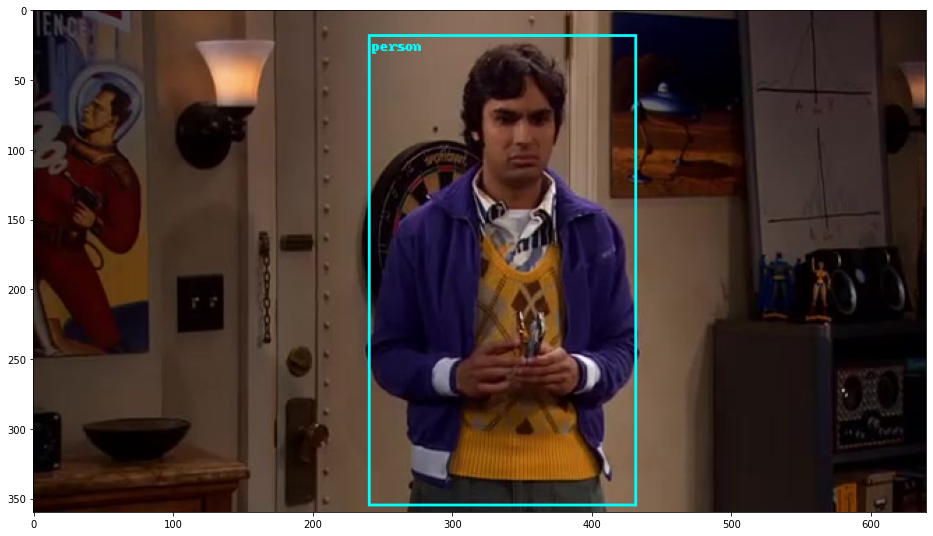

{'boxes': tensor([[169.9944,  17.7815, 425.1809, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.9740], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


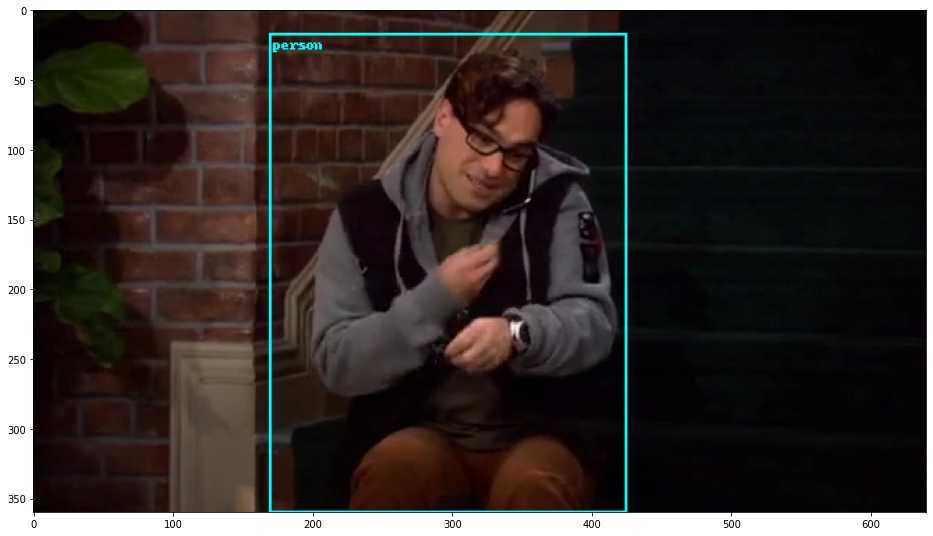

{'boxes': tensor([[209.3437,  43.0849, 470.0417, 356.6738],
        [ 12.4814, 101.7400, 290.3305, 355.9020],
        [434.3896, 242.3170, 631.9027, 355.0280]], grad_fn=<StackBackward0>), 'scores': tensor([0.9836, 0.9060, 0.6754], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 82, 79])}


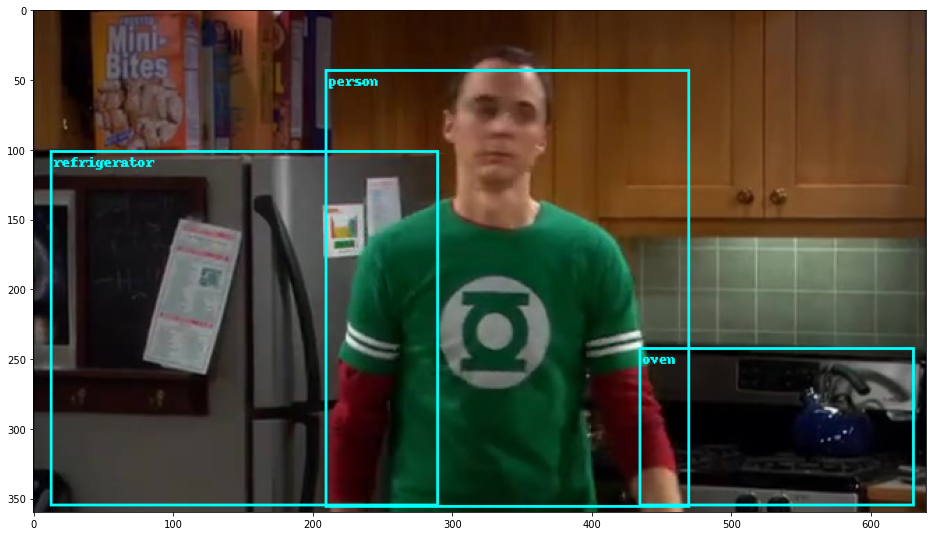

{'boxes': tensor([[192.9997,  18.2618, 474.5298, 357.2711]], grad_fn=<StackBackward0>), 'scores': tensor([0.9967], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


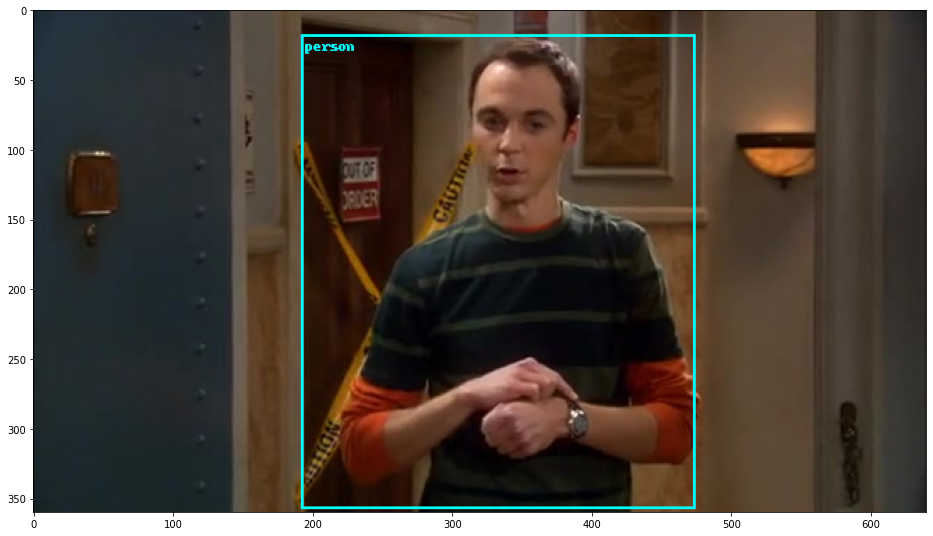

{'boxes': tensor([[105.0607,  15.7486, 305.8477, 360.0000],
        [142.6441,   4.9773, 485.8350, 353.8302]], grad_fn=<StackBackward0>), 'scores': tensor([0.9836, 0.5416], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 82])}


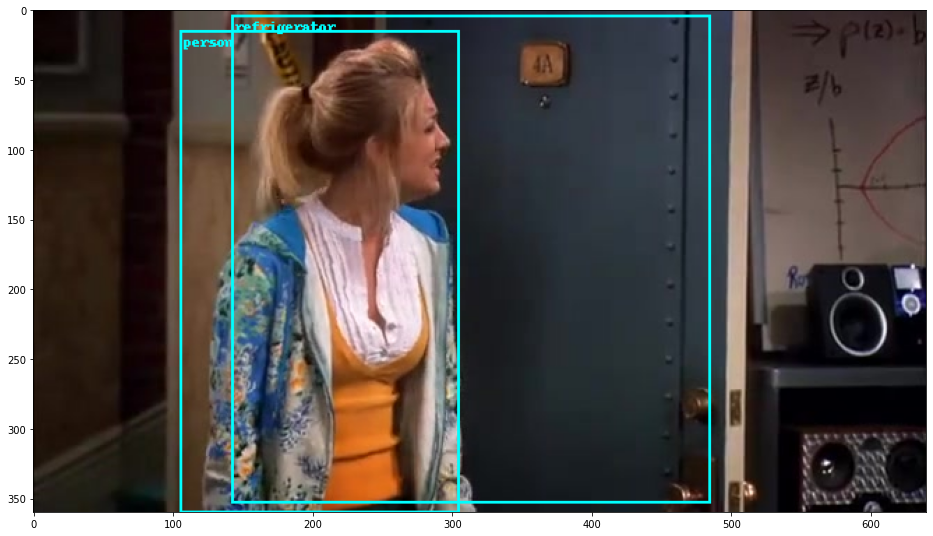

{'boxes': tensor([[112.4590,  22.6941, 421.5356, 360.0000],
        [  3.3586, 194.8210, 155.5485, 359.9131],
        [534.1384, 151.6968, 637.2791, 334.3882]], grad_fn=<StackBackward0>), 'scores': tensor([0.9963, 0.4710, 0.4139], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1, 1])}


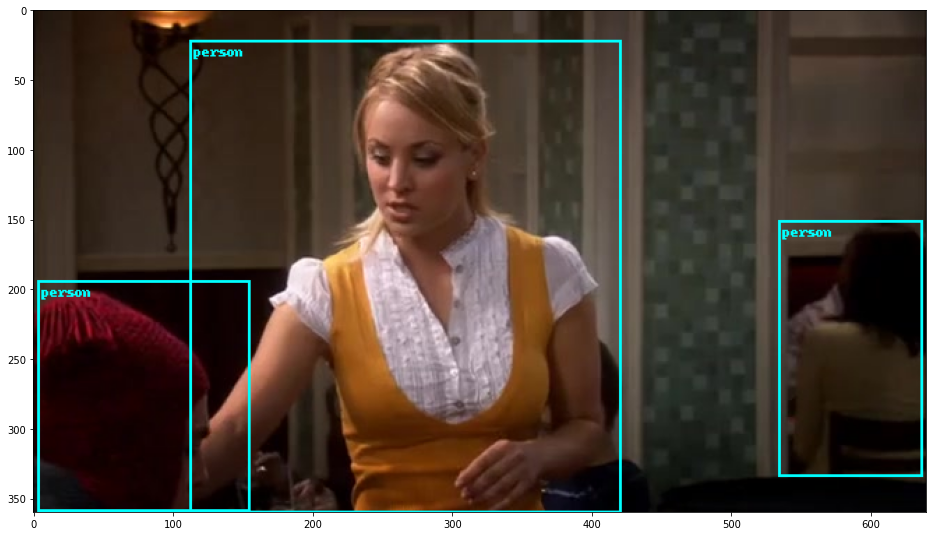

{'boxes': tensor([[213.6763,  33.2585, 448.5068, 355.2619],
        [415.6696, 134.5476, 522.4215, 200.3431],
        [448.4896, 216.9379, 566.1425, 294.6179]], grad_fn=<StackBackward0>), 'scores': tensor([0.9905, 0.4930, 0.4325], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 78, 78])}


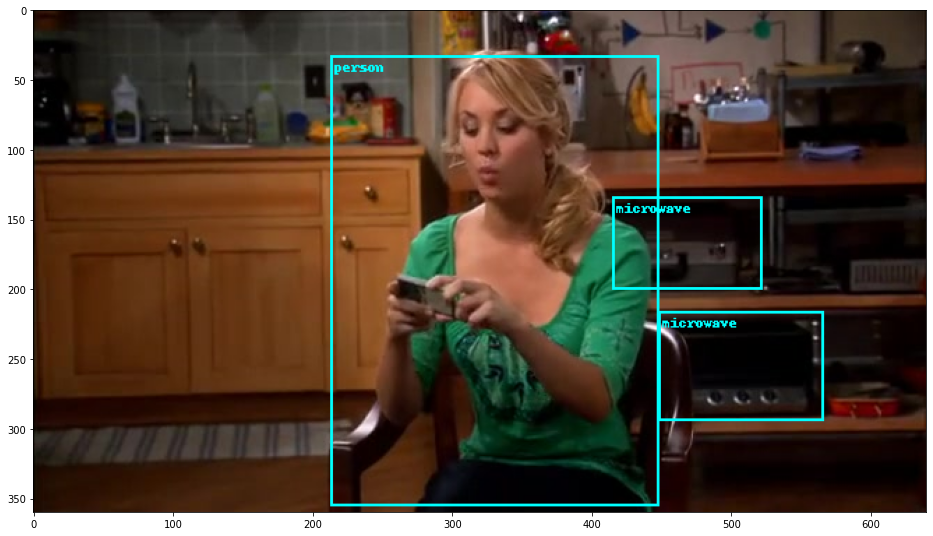

{'boxes': tensor([[151.6962,  43.7075, 489.2804, 338.3812],
        [473.9120,  54.6566, 636.8826, 316.3607]], grad_fn=<StackBackward0>), 'scores': tensor([0.9912, 0.9522], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


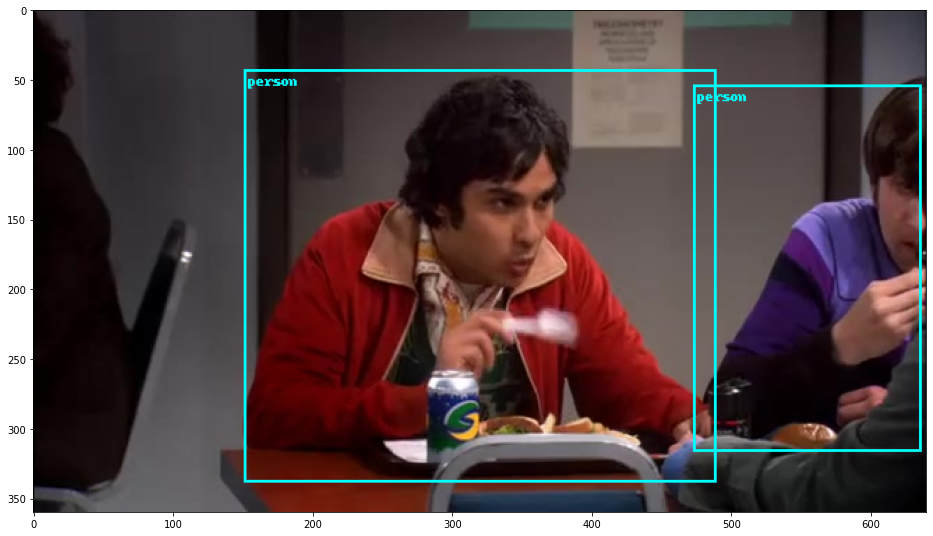

{'boxes': tensor([[145.5511,  13.3758, 428.1570, 358.6579],
        [499.3354,   0.0000, 637.8528, 356.1256]], grad_fn=<StackBackward0>), 'scores': tensor([0.9655, 0.8284], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


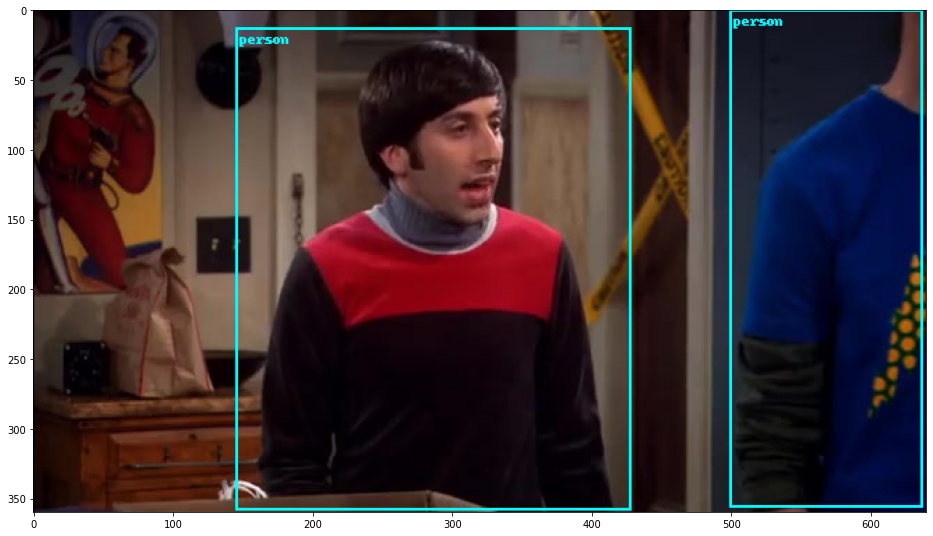

{'boxes': tensor([[239.2252,  19.4728, 437.9201, 355.2805]], grad_fn=<StackBackward0>), 'scores': tensor([0.9839], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


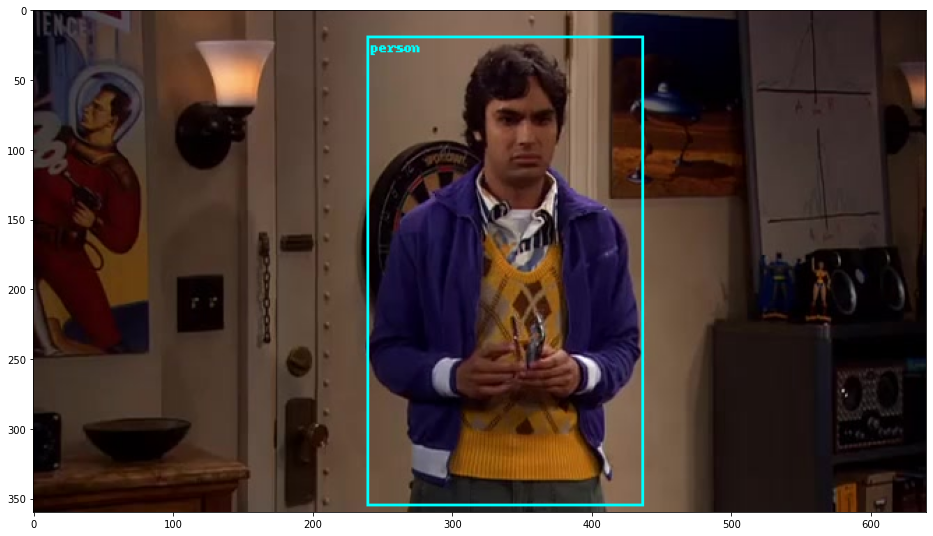

{'boxes': tensor([[192.5275,  32.9941, 433.0138, 357.2517],
        [516.4326,  12.3019, 634.4013, 360.0000]], grad_fn=<StackBackward0>), 'scores': tensor([0.9855, 0.7164], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


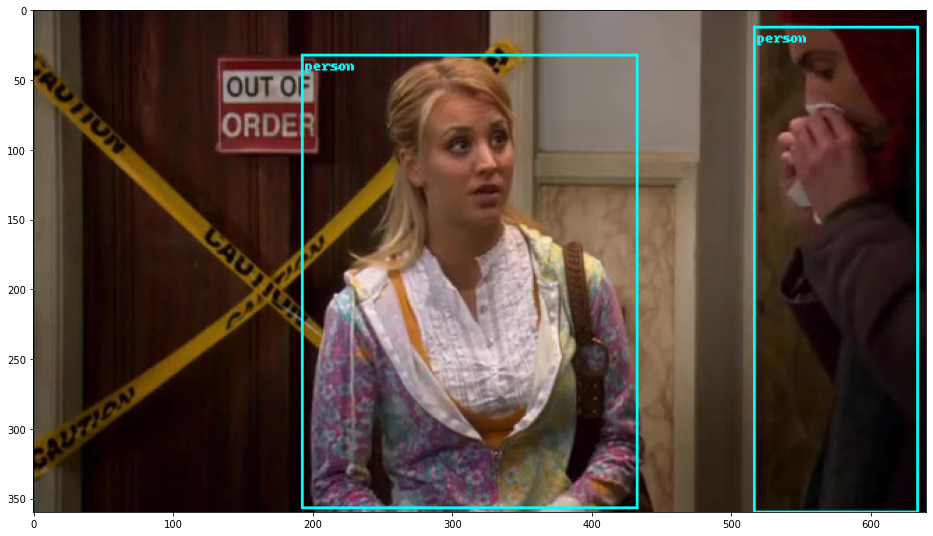

{'boxes': tensor([[225.5369,  27.0521, 498.2526, 358.4197],
        [  0.0000,  29.7842, 162.2935, 356.5803],
        [487.2508, 220.0685, 623.5941, 352.6420]], grad_fn=<StackBackward0>), 'scores': tensor([0.9951, 0.9280, 0.7319], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 62])}


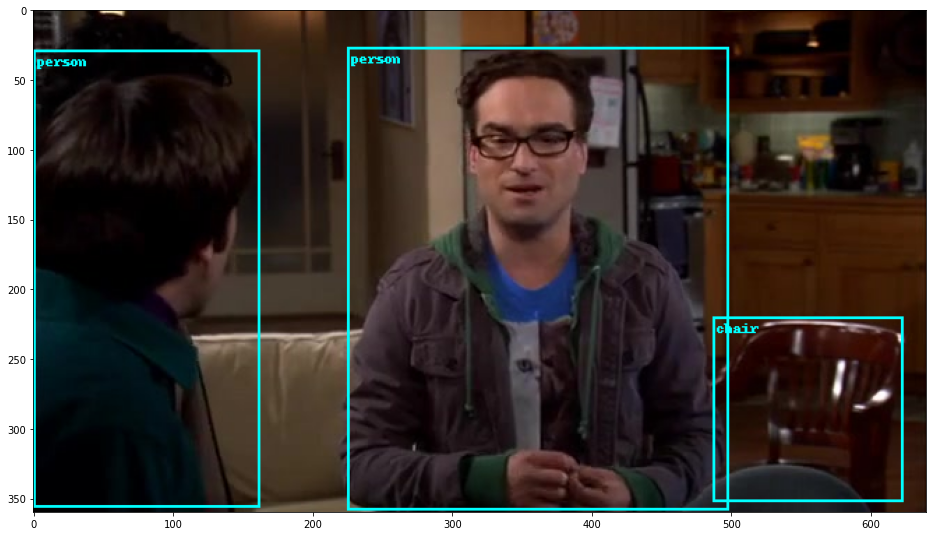

{'boxes': tensor([[216.4407,   3.3145, 522.7920, 359.6026]], grad_fn=<StackBackward0>), 'scores': tensor([0.9885], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


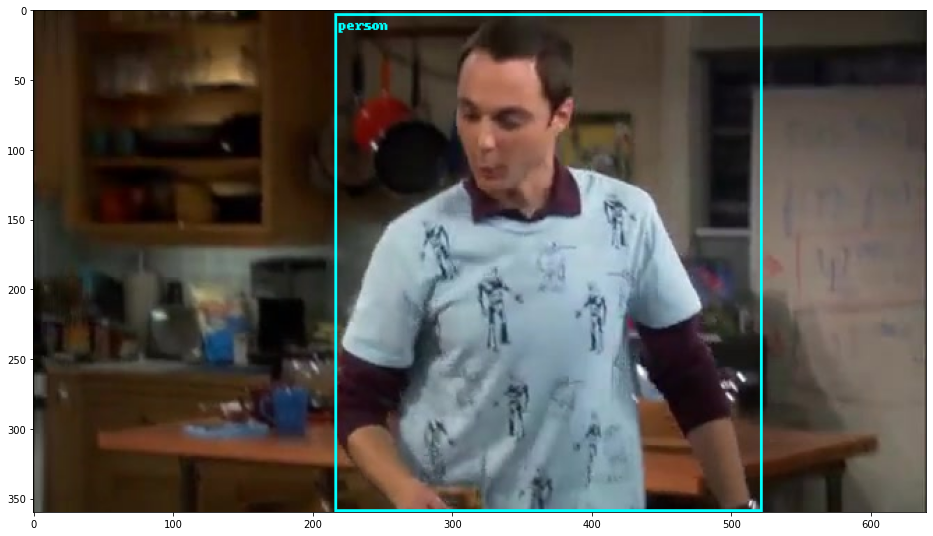

{'boxes': tensor([[139.9923,  19.2816, 459.2632, 357.1385]], grad_fn=<StackBackward0>), 'scores': tensor([0.9933], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


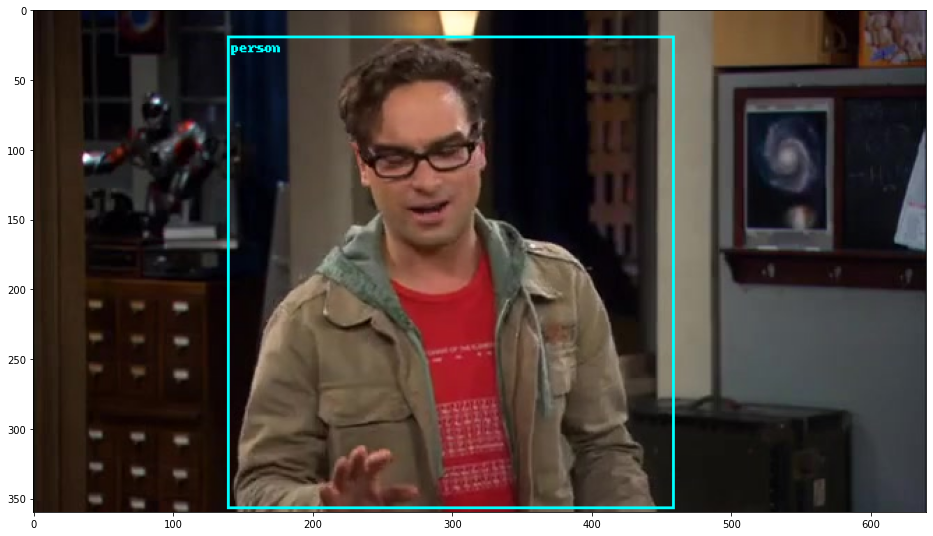

{'boxes': tensor([[257.8142,  14.0339, 485.0251, 360.0000],
        [ 29.9441, 196.9125, 251.6897, 355.0495]], grad_fn=<StackBackward0>), 'scores': tensor([0.8815, 0.4091], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 62])}


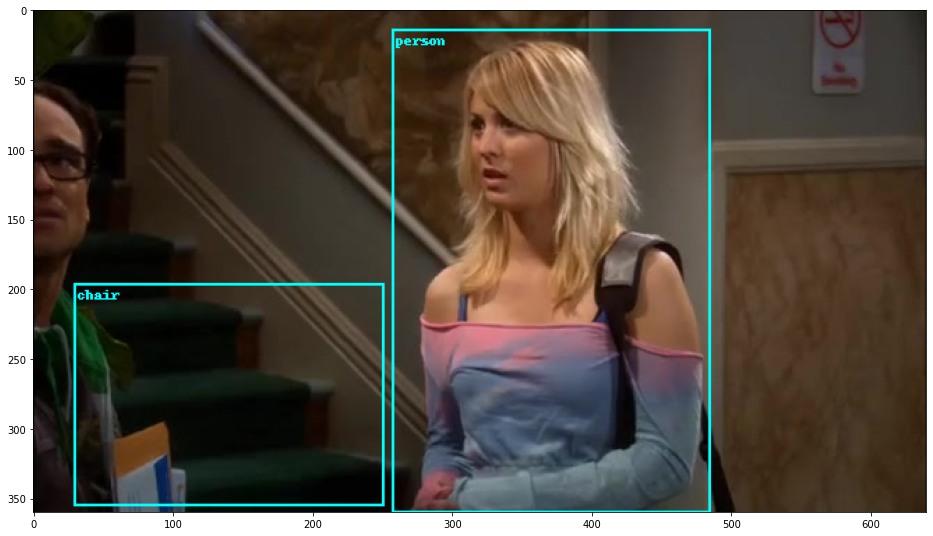

{'boxes': tensor([[154.8508,  29.0317, 452.8541, 356.3208],
        [238.8458, 142.8977, 612.8090, 359.3671]], grad_fn=<StackBackward0>), 'scores': tensor([0.9608, 0.4142], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 63])}


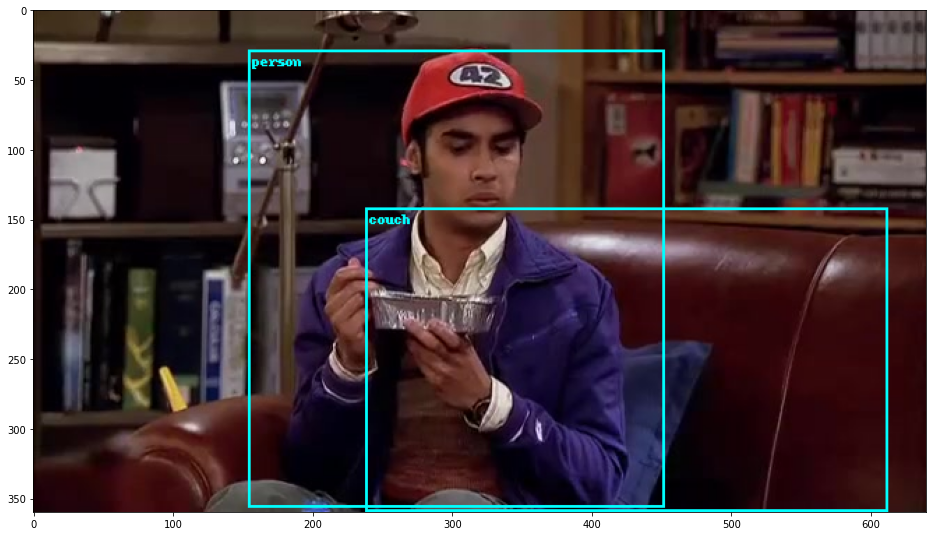

{'boxes': tensor([[150.1937,  22.7778, 494.2785, 355.5148]], grad_fn=<StackBackward0>), 'scores': tensor([0.9735], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


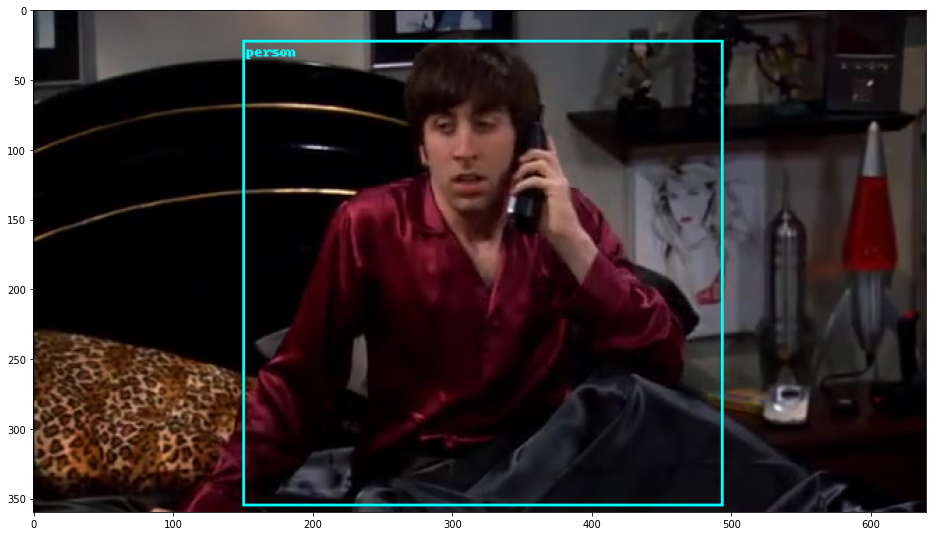

{'boxes': tensor([[134.1670,   4.4214, 517.8000, 358.7615],
        [  4.2651,   6.6341,  54.0472, 151.5998]], grad_fn=<StackBackward0>), 'scores': tensor([0.9881, 0.5991], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


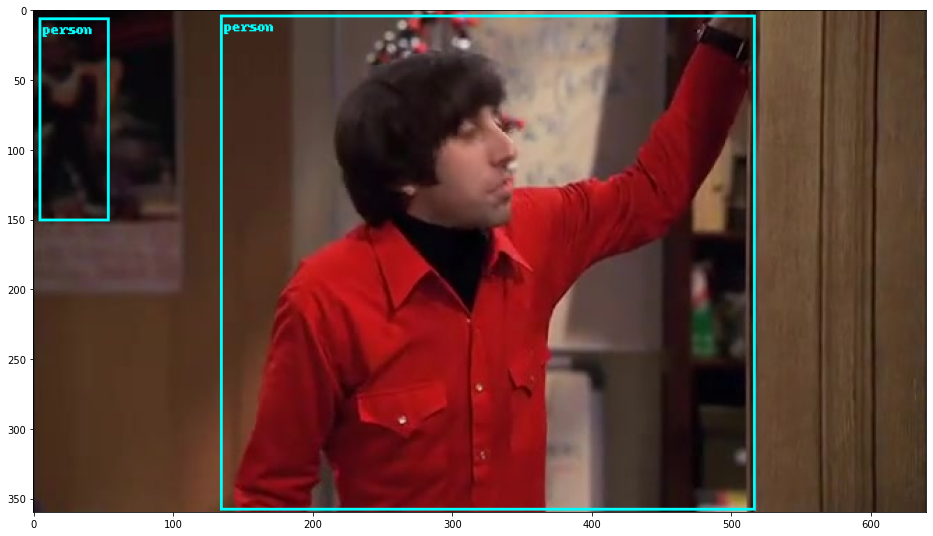

{'boxes': tensor([[170.7595,  31.0074, 457.1308, 355.7866],
        [210.7014, 142.7561, 610.2729, 358.3840]], grad_fn=<StackBackward0>), 'scores': tensor([0.9732, 0.5178], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 63])}


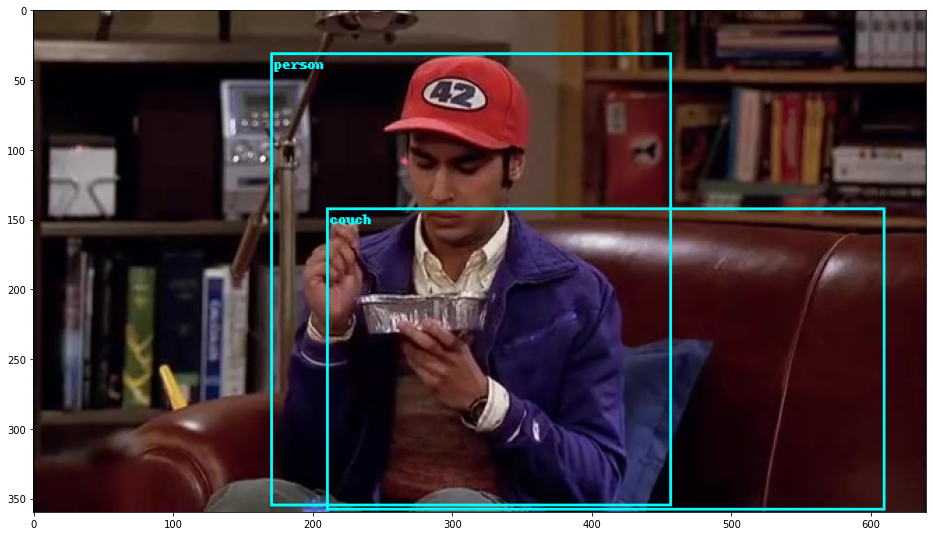

{'boxes': tensor([[205.3935,  72.1231, 431.5202, 354.6320],
        [  1.8491,  37.2558, 137.1434, 222.9256],
        [118.6142, 192.9893, 230.0544, 358.7416],
        [418.2486, 191.1259, 631.2578, 347.3698],
        [480.2393,  38.9272, 586.6248,  93.5414]], grad_fn=<StackBackward0>), 'scores': tensor([0.9957, 0.8662, 0.8559, 0.8150, 0.3792], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 79, 62, 73, 78])}


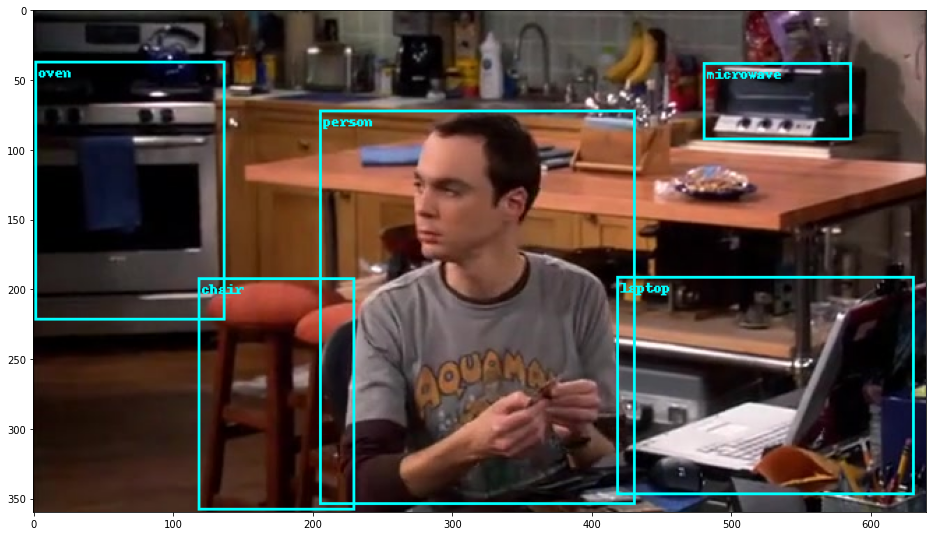

{'boxes': tensor([[105.2508,  37.7571, 349.3190, 356.2816],
        [299.8358,  57.0214, 527.7549, 356.7224]], grad_fn=<StackBackward0>), 'scores': tensor([0.9818, 0.9661], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


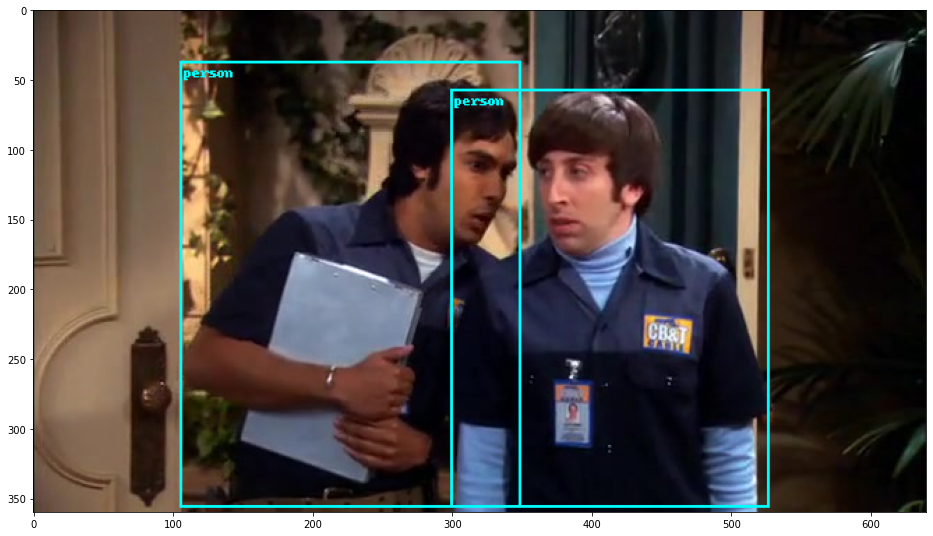

{'boxes': tensor([[156.4267,  36.9020, 486.5094, 332.9404],
        [473.7594,  53.5079, 637.0370, 316.1848]], grad_fn=<StackBackward0>), 'scores': tensor([0.9972, 0.9539], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1])}


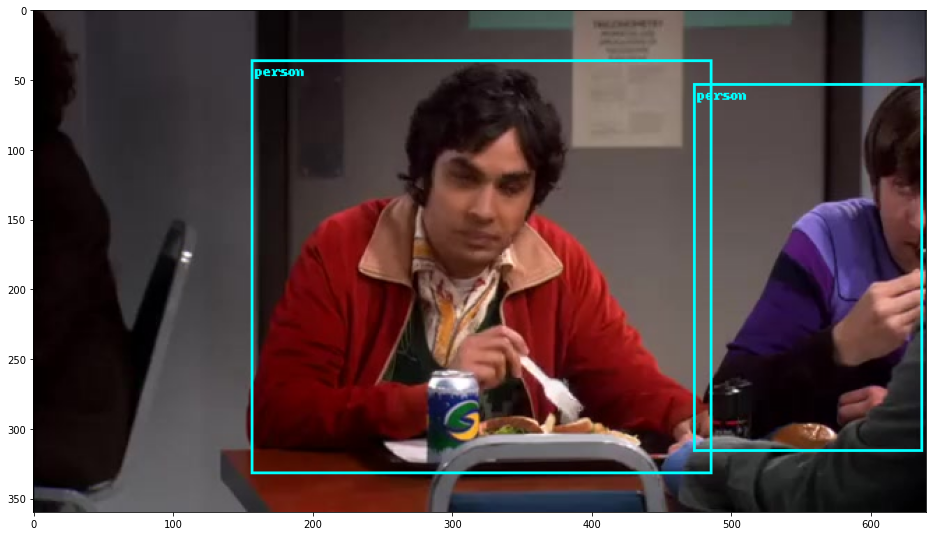

{'boxes': tensor([[166.9814,  31.4352, 412.2387, 355.5294],
        [400.9749,   1.8649, 595.3872, 359.3059]], grad_fn=<StackBackward0>), 'scores': tensor([0.9889, 0.5350], grad_fn=<IndexBackward0>), 'labels': tensor([ 1, 82])}


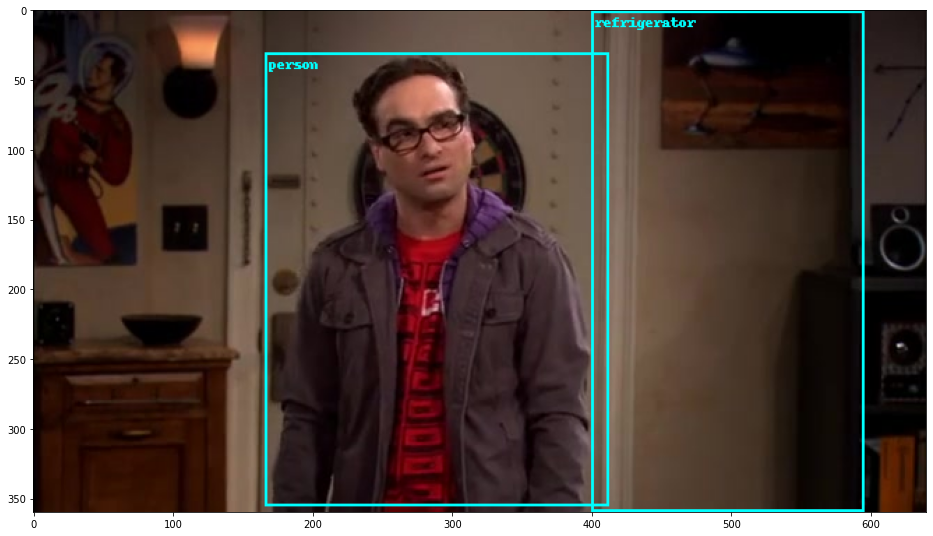

{'boxes': tensor([[170.3706,  35.9152, 517.3110, 351.8806],
        [150.2950,   0.8043, 273.3578, 206.0546],
        [  1.7983, 201.9232, 100.1544, 330.3532],
        [362.5713,  11.2723, 487.6851, 203.7035],
        [182.8217, 251.5864, 252.1353, 358.8242]], grad_fn=<StackBackward0>), 'scores': tensor([0.9509, 0.7093, 0.6718, 0.6644, 0.4848], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 62,  1, 47])}


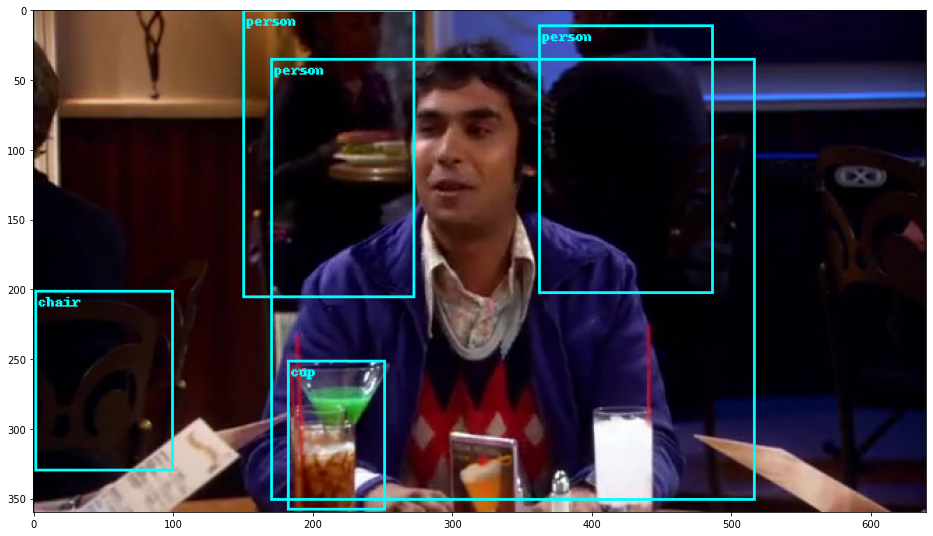

{'boxes': tensor([[113.5608,  27.4992, 429.2568, 360.0000],
        [  2.8018, 195.1463, 151.4412, 359.8286],
        [542.7162, 146.7842, 639.4943, 335.2419]], grad_fn=<StackBackward0>), 'scores': tensor([0.9939, 0.6316, 0.5078], grad_fn=<IndexBackward0>), 'labels': tensor([1, 1, 1])}


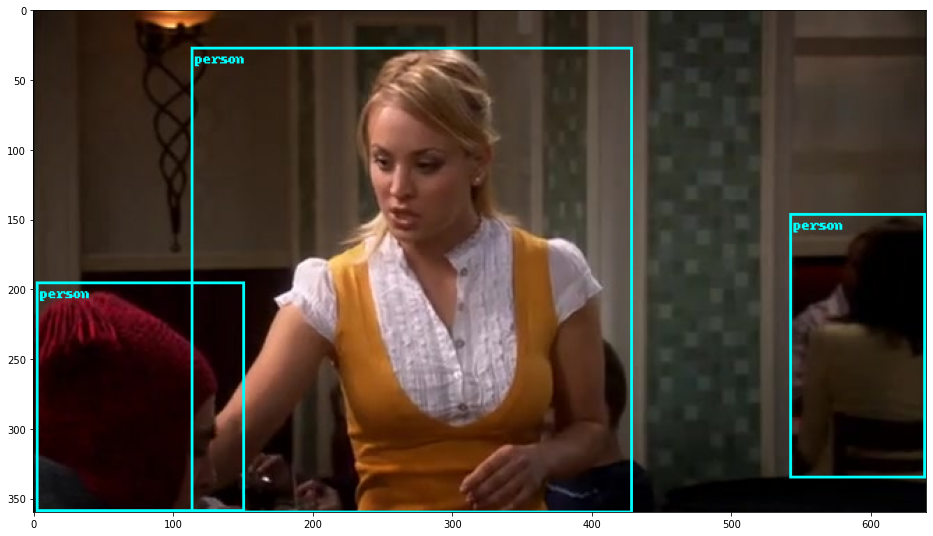

{'boxes': tensor([[213.6085,  31.8540, 443.1756, 355.6611]], grad_fn=<StackBackward0>), 'scores': tensor([0.9953], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


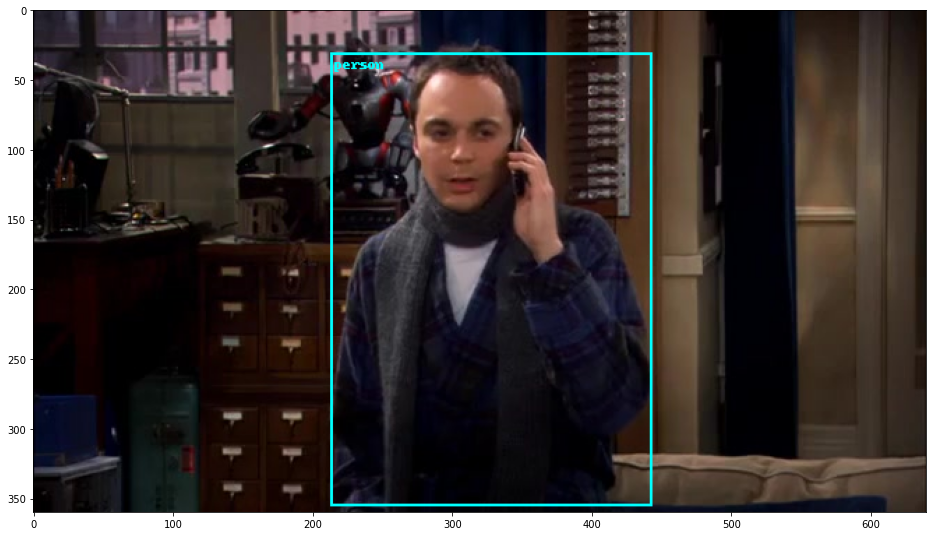

{'boxes': tensor([[188.0128,  22.8430, 503.0306, 357.4412]], grad_fn=<StackBackward0>), 'scores': tensor([0.9911], grad_fn=<IndexBackward0>), 'labels': tensor([1])}


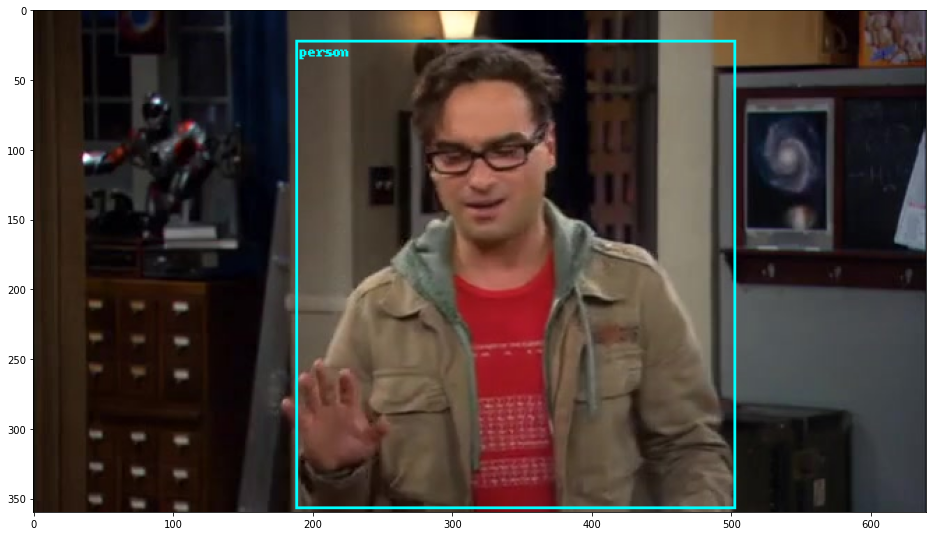

{'boxes': tensor([[104.3962,  69.5269, 439.7717, 358.3064],
        [455.9495, 133.9688, 631.6471, 358.2323],
        [ 89.6673,   2.5405, 206.3292, 224.4714]], grad_fn=<StackBackward0>), 'scores': tensor([0.8489, 0.8396, 0.5950], grad_fn=<IndexBackward0>), 'labels': tensor([ 1,  1, 64])}


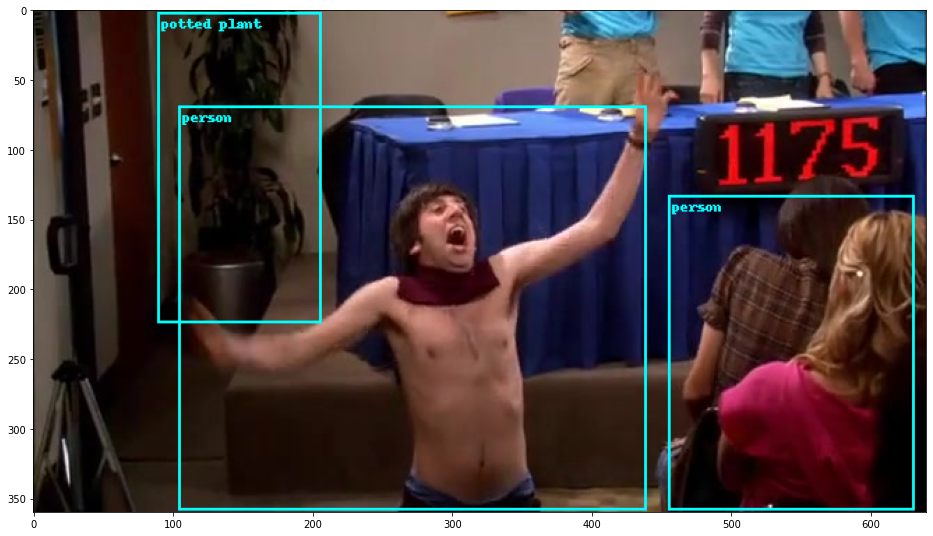

In [23]:
for c, img in enumerate(imgList):

  batch = [preprocess(img)]
  prediction = model(batch)[0]
  print(prediction)
  labels = [weights.meta["categories"][i] for i in prediction["labels"]]

  box = draw_bounding_boxes(img, boxes=prediction["boxes"],
                            labels=labels,
                            colors="cyan",
                            width=2, 
                            font_size=50)

  im = to_pil_image(box.detach())

  fig, ax = plt.subplots(figsize=(16, 12))
  ax.imshow(im)
  plt.show()

  # if c == 5:
  #   break

In [5]:
!pip install -q git+https://github.com/huggingface/transformers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


In [6]:
from transformers import YolosFeatureExtractor, YolosForObjectDetection
from PIL import Image
import requests

url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
image = Image.open(requests.get(url, stream=True).raw)

feature_extractor = YolosFeatureExtractor.from_pretrained('hustvl/yolos-tiny')
model = YolosForObjectDetection.from_pretrained('hustvl/yolos-tiny')

inputs = feature_extractor(images=imgList[0:2], return_tensors="pt")
outputs = model(**inputs)

# model predicts bounding boxes and corresponding COCO classes
logits = outputs.logits
bboxes = outputs.pred_boxes

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


Moving 0 files to the new cache system


0it [00:00, ?it/s]

In [11]:
print(inputs.pixel_values.shape)

torch.Size([2, 3, 512, 910])


In [25]:
import torch
from torchvision import models
from torch.hub import load_state_dict_from_url


# Define the architecture by modifying resnet.
# Original code is here
# https://github.com/pytorch/vision/blob/b2e95657cd5f389e3973212ba7ddbdcc751a7878/torchvision/models/resnet.py
class ResNet101(models.ResNet):
    def __init__(self, num_classes=1000, pretrained=True, **kwargs):
        # Start with standard resnet101 defined here
        # https://github.com/pytorch/vision/blob/b2e95657cd5f389e3973212ba7ddbdcc751a7878/torchvision/models/resnet.py
        super().__init__(block=models.resnet.Bottleneck, layers=[3, 4, 23, 3], num_classes=num_classes, **kwargs)
        if pretrained:
            state_dict = load_state_dict_from_url(models.resnet.model_urls['resnet101'], progress=True)
            self.load_state_dict(state_dict)

    # Reimplementing forward pass.
    # Replacing the following code
    # https://github.com/pytorch/vision/blob/b2e95657cd5f389e3973212ba7ddbdcc751a7878/torchvision/models/resnet.py#L197-L213
    def _forward_impl(self, x):
        # Standard forward for resnet
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        # Notice there is no forward pass through the original classifier.
        x = self.avgpool(x)
        x = torch.flatten(x, 1)

        return x


In [26]:
from os import path, listdir
import torch
from torchvision import transforms
import random

from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

# processes Animals10 dataset: https://www.kaggle.com/alessiocorrado99/animals10
class AnimalsDataset(torch.utils.data.Dataset):
    def __init__(self, data_path, num_images=1000):

        if not path.exists(data_path):
            raise Exception(data_path + ' does not exist!')

        self.data = []

        folders = listdir(data_path)
        
        for folder in folders:
          full_path = path.join(data_path, folders[1])
          images = listdir(full_path)

        current_data = [(path.join(full_path, image)) for image in images]
        self.data += current_data

        num_images = min(num_images, len(self.data))
        self.data = random.sample(self.data, num_images) # only use num_images images

        # We use the transforms described in official PyTorch ResNet inference example:
        # https://pytorch.org/hub/pytorch_vision_resnet/.
        self.transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])


    def __len__(self):
        return len(self.data)


    def __getitem__(self, index):
        image_path = self.data[index]

        image = Image.open(image_path)

        try:
            image = self.transform(image) # some images in the dataset cannot be processed - we'll skip them
        except Exception:
            return None

        dict_data = {
            'image' : image,
            'image_path' : image_path
        }
        return dict_data


# Skips empty samples in a batch
def collate_skip_empty(batch):
    batch = [sample for sample in batch if sample] # check that sample is not None
    return torch.utils.data.dataloader.default_collate(batch)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
Running the model inference: 100%|██████████| 3/3 [01:00<00:00, 20.08s/it]
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
Building the T-SNE plot: 100%|██████████| 179/179 [00:00<00:00, 241.78it/s]


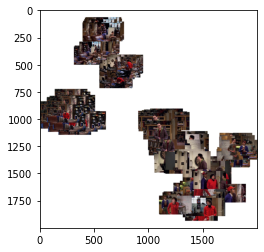

In [29]:

import argparse
from tqdm import tqdm
import cv2
import torch
import random
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt


def fix_random_seeds():
    seed = 10
    random.seed(seed)
    torch.manual_seed(seed)
    np.random.seed(seed)


def get_features(dataset, batch, num_images):
    # move the input and model to GPU for speed if available
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'

    # initialize our implementation of ResNet
    model = ResNet101(pretrained=True)
    model.eval()
    model.to(device)

    # read the dataset and initialize the data loader
    dataset = AnimalsDataset(dataset, num_images)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch, collate_fn=collate_skip_empty, shuffle=True)

    # we'll store the features as NumPy array of size num_images x feature_size
    features = None

    # we'll also store the image labels and paths to visualize them later
    labels = []
    image_paths = []

    for batch in tqdm(dataloader, desc='Running the model inference'):
        images = batch['image'].to(device)
        image_paths += batch['image_path']

        with torch.no_grad():
            output = model.forward(images)

        current_features = output.cpu().numpy()
        if features is not None:
            features = np.concatenate((features, current_features))
        else:
            features = current_features

    return features, image_paths


# scale and move the coordinates so they fit [0; 1] range
def scale_to_01_range(x):
    # compute the distribution range
    value_range = (np.max(x) - np.min(x))

    # move the distribution so that it starts from zero
    # by extracting the minimal value from all its values
    starts_from_zero = x - np.min(x)

    # make the distribution fit [0; 1] by dividing by its range
    return starts_from_zero / value_range


def scale_image(image, max_image_size):
    image_height, image_width, _ = image.shape

    scale = max(1, image_width / max_image_size, image_height / max_image_size)
    image_width = int(image_width / scale)
    image_height = int(image_height / scale)

    image = cv2.resize(image, (image_width, image_height))
    return image


def draw_rectangle_by_class(image, label):
    image_height, image_width, _ = image.shape

    # get the color corresponding to image class
    color = colors_per_class[label]
    image = cv2.rectangle(image, (0, 0), (image_width - 1, image_height - 1), color=color, thickness=5)

    return image


def compute_plot_coordinates(image, x, y, image_centers_area_size, offset):
    image_height, image_width, _ = image.shape

    # compute the image center coordinates on the plot
    center_x = int(image_centers_area_size * x) + offset

    # in matplotlib, the y axis is directed upward
    # to have the same here, we need to mirror the y coordinate
    center_y = int(image_centers_area_size * (1 - y)) + offset

    # knowing the image center, compute the coordinates of the top left and bottom right corner
    tl_x = center_x - int(image_width / 2)
    tl_y = center_y - int(image_height / 2)

    br_x = tl_x + image_width
    br_y = tl_y + image_height

    return tl_x, tl_y, br_x, br_y


def visualize_tsne_images(tx, ty, images, plot_size=2000, max_image_size=200):
    # we'll put the image centers in the central area of the plot
    # and use offsets to make sure the images fit the plot
    offset = max_image_size // 2
    image_centers_area_size = plot_size - 2 * offset

    tsne_plot = 255 * np.ones((plot_size, plot_size, 3), np.uint8)

    # now we'll put a small copy of every image to its corresponding T-SNE coordinate
    for image_path, x, y in tqdm(
            zip(images, tx, ty),
            desc='Building the T-SNE plot',
            total=len(images)
    ):
        image = cv2.imread(image_path)

        # scale the image to put it to the plot
        image = scale_image(image, max_image_size)

        # # draw a rectangle with a color corresponding to the image class
        # image = draw_rectangle_by_class(image, label)

        # compute the coordinates of the image on the scaled plot visualization
        tl_x, tl_y, br_x, br_y = compute_plot_coordinates(image, x, y, image_centers_area_size, offset)

        # put the image to its TSNE coordinates using numpy subarray indices
        tsne_plot[tl_y:br_y, tl_x:br_x, :] = image

    plt.imshow(tsne_plot[:, :, ::-1])
    plt.savefig('visual_features_tsne.png', bbox_inches='tight', dpi=2000)
    plt.show()


def visualize_tsne_points(tx, ty, labels):
    # initialize matplotlib plot
    fig = plt.figure()
    ax = fig.add_subplot(111)

    # for every class, we'll add a scatter plot separately
    for label in colors_per_class:
        # find the samples of the current class in the data
        indices = [i for i, l in enumerate(labels) if l == label]

        # extract the coordinates of the points of this class only
        current_tx = np.take(tx, indices)
        current_ty = np.take(ty, indices)

        # convert the class color to matplotlib format:
        # BGR -> RGB, divide by 255, convert to np.array
        color = np.array([colors_per_class[label][::-1]], dtype=np.float) / 255

        # add a scatter plot with the correponding color and label
        ax.scatter(current_tx, current_ty, c=color, label=label)

    # build a legend using the labels we set previously
    ax.legend(loc='best')

    # finally, show the plot
    plt.show()


def visualize_tsne(tsne, images, plot_size=2000, max_image_size=300):
    # extract x and y coordinates representing the positions of the images on T-SNE plot
    tx = tsne[:, 0]
    ty = tsne[:, 1]

    # scale and move the coordinates so they fit [0; 1] range
    tx = scale_to_01_range(tx)
    ty = scale_to_01_range(ty)

    # # visualize the plot: samples as colored points
    # visualize_tsne_points(tx, ty, labels)

    # visualize the plot: samples as images
    visualize_tsne_images(tx, ty, images, plot_size=plot_size, max_image_size=max_image_size)

fix_random_seeds()

features, image_paths = get_features(
    dataset="/content/",
    batch=64,
    num_images=200
)

tsne = TSNE(n_components=2).fit_transform(features)

visualize_tsne(tsne, image_paths)


